# Import libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [33]:
df = pd.read_csv(r"D:\Work\Ahsan\Energy star\ENERGY_STAR_Certified_Computers_20241128.csv")

# Column names

In [63]:
for i in df.columns:
    print(i)

ENERGY STAR Partner
Brand Name
Model Name
Model Number
Additional Model Information
UPC
Type
Touch Screen
Notebooks, Desktops, Integrated Computers, Slate/Tablets, Two-in-one Notebooks, and Portable All-in-ones Category for TEC (Typical Energy Consumption) Criteria
Category 0: Processor Brand
Category 0: Processor Name
Category 0: Operating System Name
Category 0: Base Processor Speed Per Core (GHz)
Category 0: Physical CPU Cores (count)
Category 0: System Memory (GB)
Category 0: Graphics Category
Category 0: Default Low-power Mode
Category 0: Long Idle Power Used for Sleep Mode
Category 0: Off Mode (watts)
Category 0: Sleep Mode (watts)
Category 0: Long Idle (watts)
Category 0: Short Idle (watts)
Category 0: Base TEC Allowance (kWh)
Category 0: Functional Adder Allowances (kWh)
Category 0: TEC of Model (kWh)
Category 1: Processor Brand
Category 1: Processor Name
Category 1: Operating System Name
Category 1: Base Processor Speed Per Core (GHz)
Category 1: Physical CPU Cores (count)
Cat

# Histograms - `Base Processor Speed Per Core (GHz)`

**Description:**

A histogram of processor speeds can reveal the distribution of processing power among the models. Clusters in the data might indicate standard configurations offered by manufacturers. This visualization can help identify the most common processor speeds and outliers that may represent high-performance or low-end models.

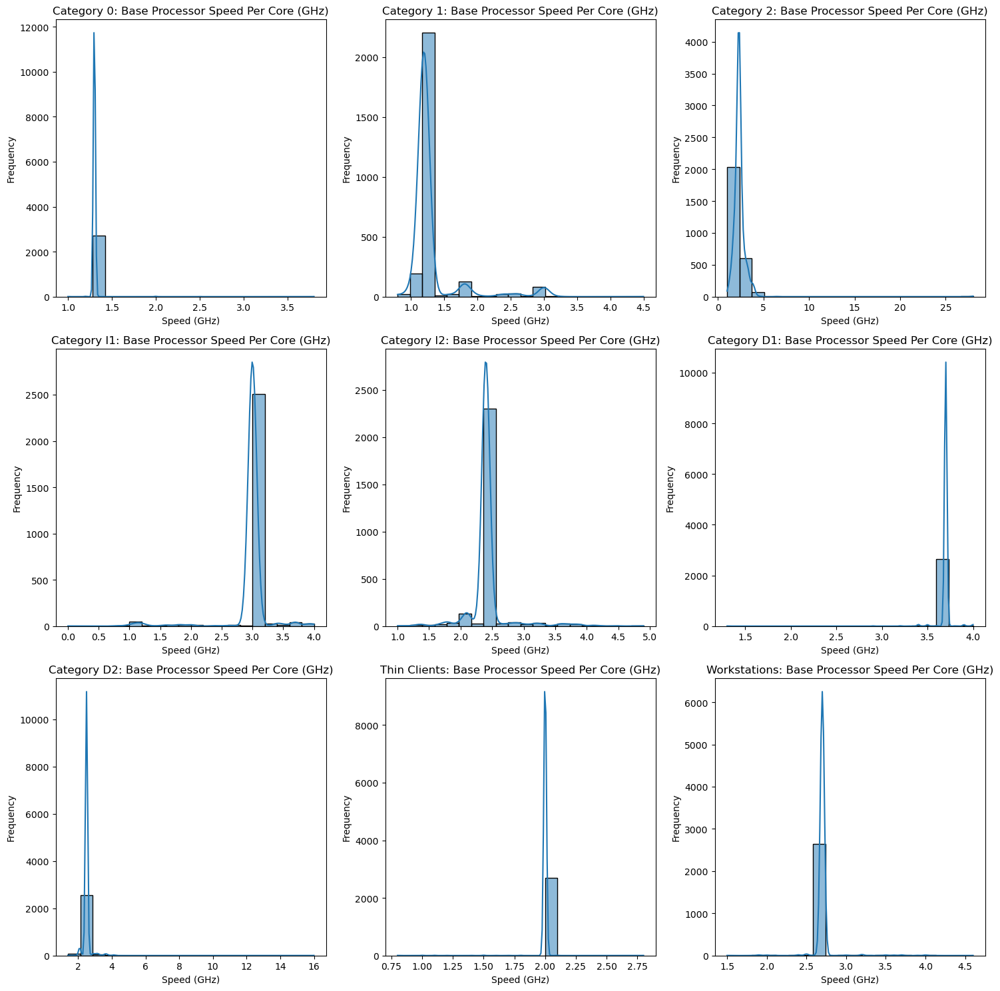

In [81]:
def plot_histograms(data):
    processor_speed_cols = [col for col in data.columns if 'Base Processor Speed Per Core' in col]
    num_cols = len(processor_speed_cols)
    fig, axes = plt.subplots(nrows=(num_cols + 2) // 3, ncols=3, figsize=(15, 5 * ((num_cols + 2) // 3)))

    for i, col in enumerate(processor_speed_cols):
        ax = axes[i // 3, i % 3]
        sns.histplot(data[col].dropna(), kde=True, bins=20, ax=ax)
        ax.set_title(col)
        ax.set_xlabel('Speed (GHz)')
        ax.set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Call the function
plot_histograms(df)

# Bar Chart - `Physical CPU Cores (count)`

**Description:**

A bar chart showing the frequency of different CPU core counts will highlight the prevalence of dual-core, quad-core, or higher configurations. It helps in understanding market trends and which core count is most popular for specific device categories.

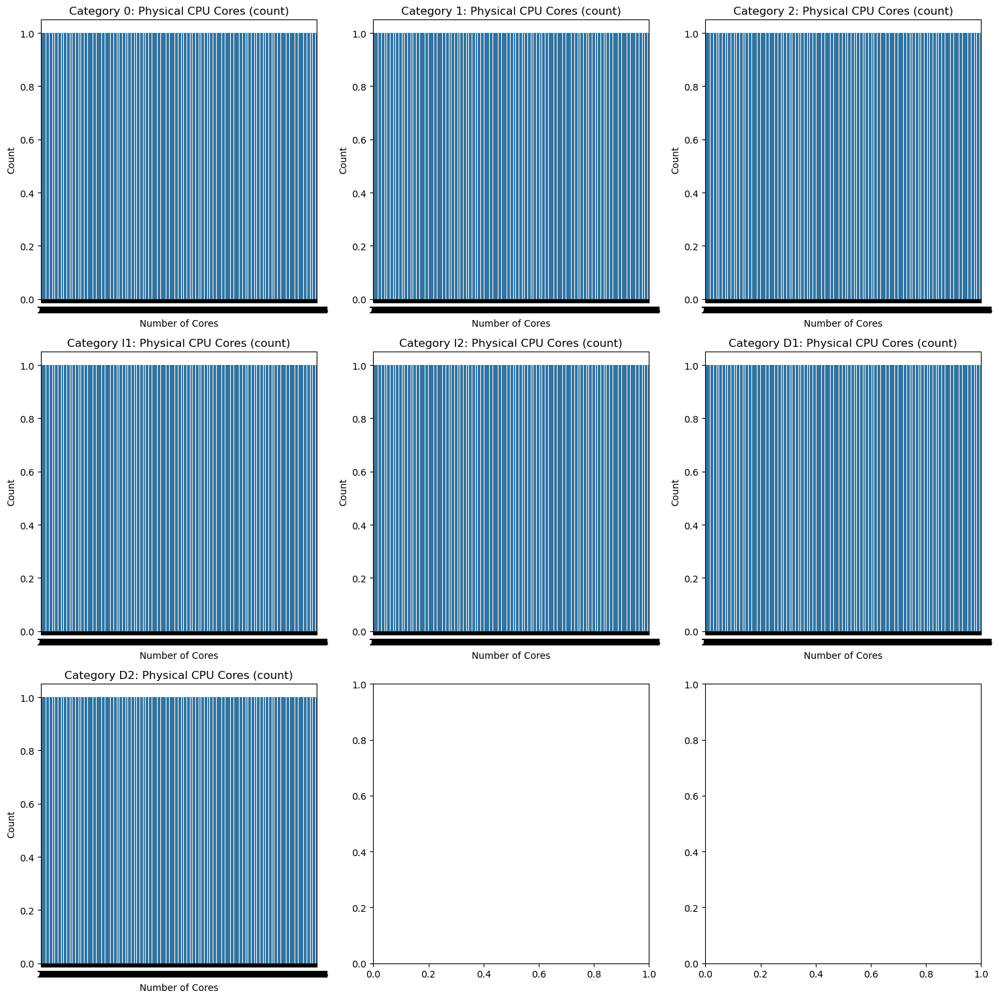

In [83]:
def plot_bar_charts(data):
    core_cols = [col for col in data.columns if 'Physical CPU Cores' in col]
    num_cols = len(core_cols)
    fig, axes = plt.subplots(nrows=(num_cols + 2) // 3, ncols=3, figsize=(15, 5 * ((num_cols + 2) // 3)))

    for i, col in enumerate(core_cols):
        ax = axes[i // 3, i % 3]
        sns.countplot(data[col].dropna(), ax=ax)
        ax.set_title(col)
        ax.set_xlabel('Number of Cores')
        ax.set_ylabel('Count')

    plt.tight_layout()
    plt.show()

# Call the function
plot_bar_charts(df)

# Boxplot - `System Memory (GB)`

**Description:**

A boxplot for system memory can provide insight into the spread, median, and potential outliers of memory configurations. Comparing boxplots across device categories (e.g., notebooks vs. workstations) can also reveal category-specific trends.

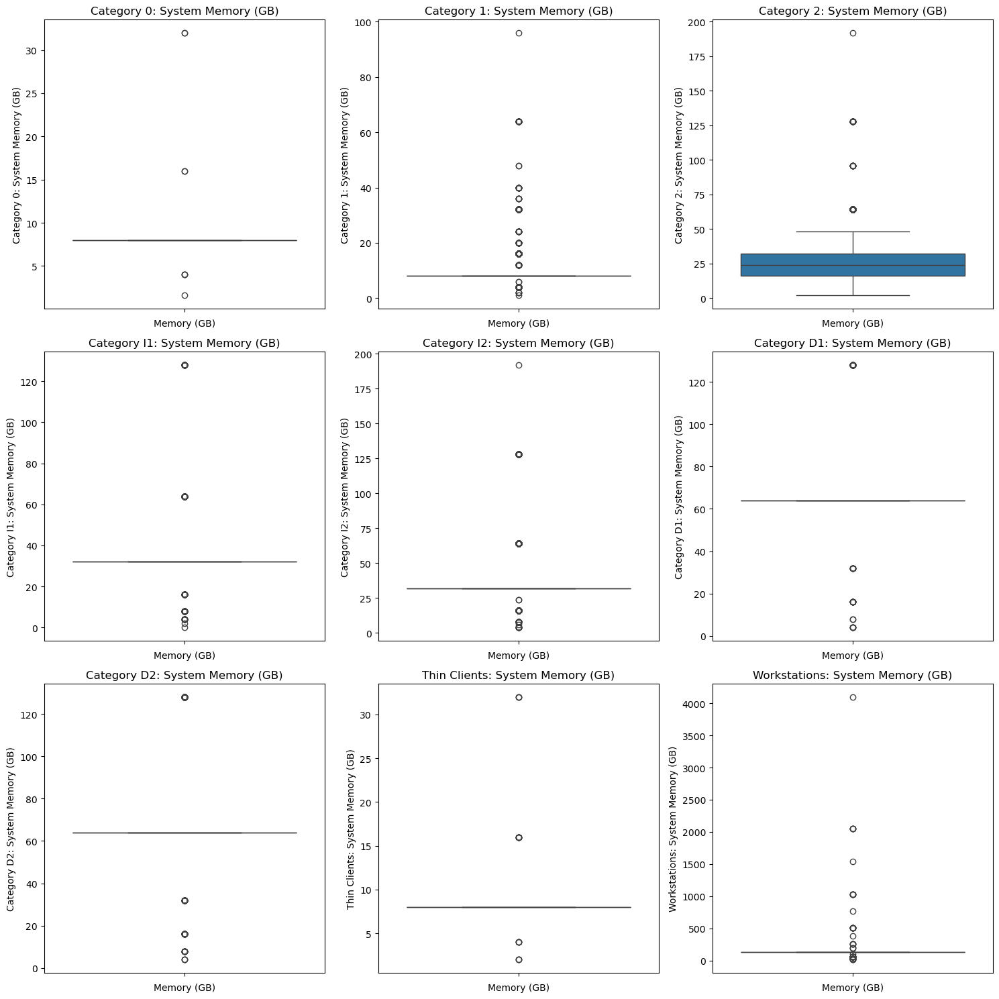

In [84]:
def plot_boxplots(data):
    memory_cols = [col for col in data.columns if 'System Memory' in col]
    num_cols = len(memory_cols)
    fig, axes = plt.subplots(nrows=(num_cols + 2) // 3, ncols=3, figsize=(15, 5 * ((num_cols + 2) // 3)))

    for i, col in enumerate(memory_cols):
        ax = axes[i // 3, i % 3]
        sns.boxplot(data[col].dropna(), ax=ax)
        ax.set_title(col)
        ax.set_xlabel('Memory (GB)')

    plt.tight_layout()
    plt.show()

# Call the function
plot_boxplots(df)

# Violin Plot - `TEC of Model (kWh)`

**Description:**

The TEC (Typical Energy Consumption) of models can be visualized with a violin plot to understand the distribution and density of energy consumption. This helps identify how energy-efficient most devices are and the range of variability in the dataset.

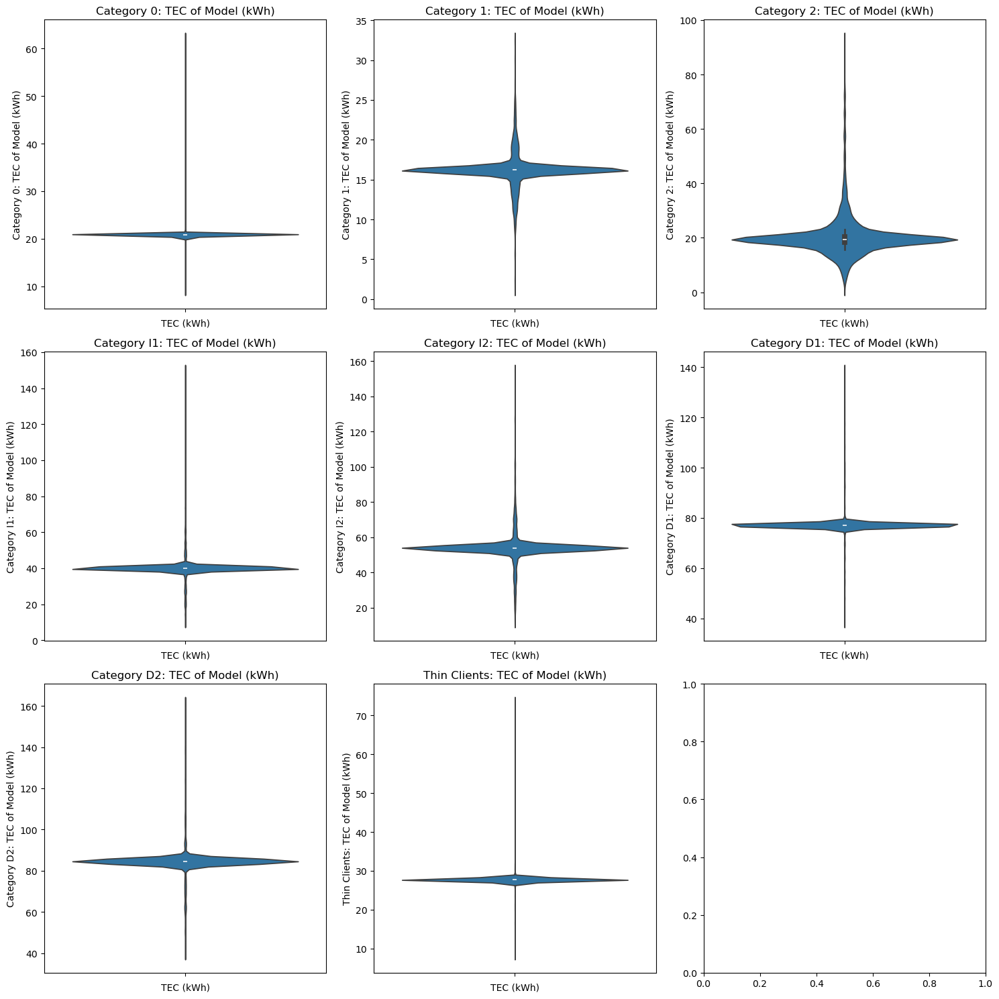

In [89]:
def plot_violin_plots(data):
    tec_cols = [col for col in data.columns if 'TEC of Model' in col]
    num_cols = len(tec_cols)
    fig, axes = plt.subplots(nrows=(num_cols + 2) // 3, ncols=3, figsize=(15, 5 * ((num_cols + 2) // 3)))

    for i, col in enumerate(tec_cols):
        ax = axes[i // 3, i % 3]
        sns.violinplot(data[col].dropna(), ax=ax)
        ax.set_title(col)
        ax.set_xlabel('TEC (kWh)')

    plt.tight_layout()
    plt.show()

# Call the function
plot_violin_plots(df)


# Pie Chart - `Processor Brand`

**Description:**

A pie chart of processor brands provides a visual representation of market share within the dataset. This can help determine which brands dominate the market or are less represented.

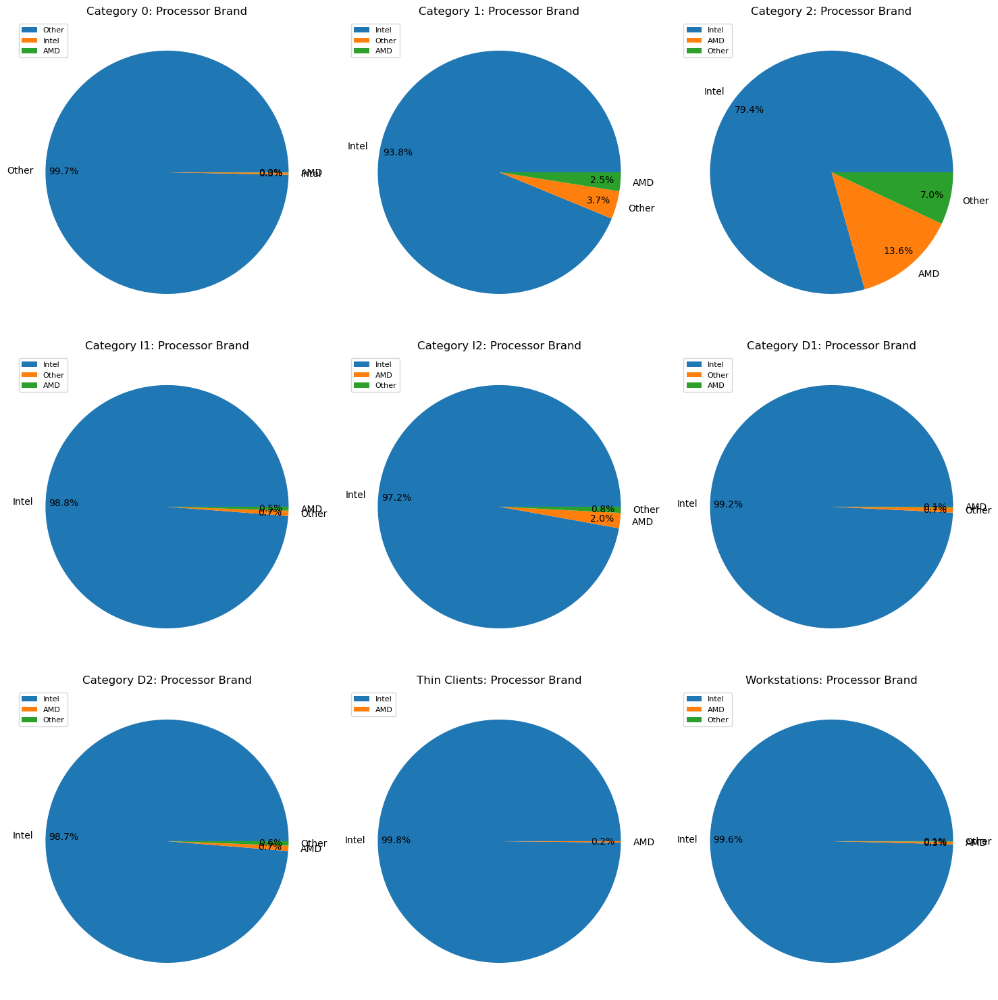

In [110]:
import matplotlib.pyplot as plt

def plot_pie_charts(data):
    brand_cols = [col for col in data.columns if 'Processor Brand' in col]
    num_cols = len(brand_cols)
    fig, axes = plt.subplots(nrows=(num_cols + 2) // 3, ncols=3, figsize=(15, 5 * ((num_cols + 2) // 3)))

    for i, col in enumerate(brand_cols):
        ax = axes[i // 3, i % 3]
        brand_counts = data[col].value_counts()
        
        # Plot the pie chart
        brand_counts.plot.pie(
            autopct='%1.1f%%', 
            ax=ax, 
            labeldistance=1.1,  # Move the labels away from the center
            pctdistance=0.85,   # Adjust the percentage label distance
            fontsize=10         # Decrease the font size
        )
        
        ax.set_title(col)
        ax.set_ylabel('')
        
        # Optionally, add a legend if the labels are too small
        ax.legend(brand_counts.index, loc='upper left', fontsize=8)

    plt.tight_layout()
    plt.show()

# Call the function
plot_pie_charts(df)

# Bar Chart (Stacked) - `WLAN Capability`

**Description:**

A stacked bar chart showing WLAN capability (e.g., 802.11a/b/g/n/ac/ax) across categories like notebooks, desktops, and workstations. This visualization can indicate the adoption of modern wireless standards in different device types.

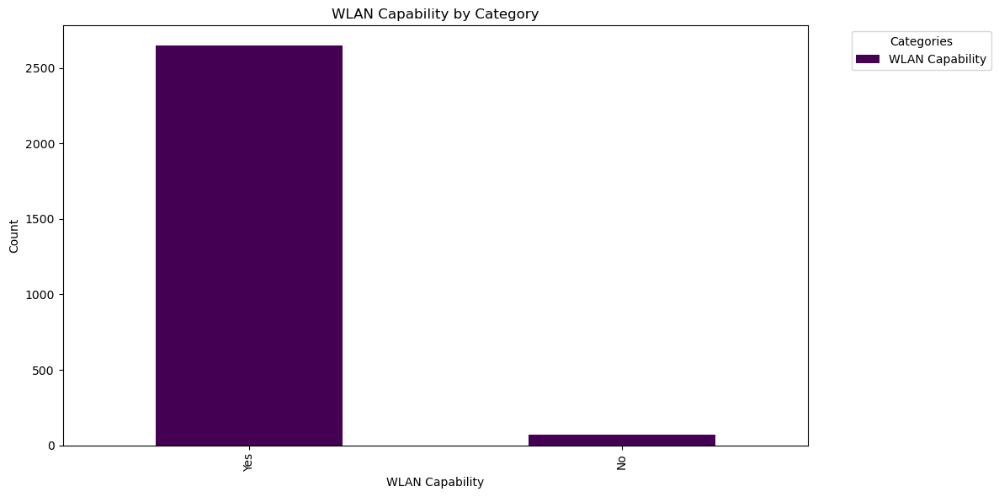

In [140]:
def plot_stacked_bar_wlan(data):
    wlan_cols = [col for col in data.columns if "WLAN Capability" in col]
    if wlan_cols:
        stacked_data = data[wlan_cols].apply(pd.Series.value_counts).fillna(0).astype(int)
        stacked_data.plot(
            kind='bar',
            stacked=True,
            figsize=(12, 6),
            colormap='viridis'
        )
        plt.title('WLAN Capability by Category')
        plt.xlabel('WLAN Capability')
        plt.ylabel('Count')
        plt.legend(title='Categories', labels=wlan_cols, bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        plt.show()
    else:
        print(f"No columns with WLAN Capability found.")

# Call the function
plot_stacked_bar_wlan(df)

# Scatter Plot - `Long Idle Power Used for Sleep Mode`

**Description:**

A scatter plot comparing Long Idle Power Used for Sleep Mode against Base Processor Speed Per Core (GHz) can reveal if there is any correlation between processing power and power consumption in idle states. This could highlight energy efficiency trends.

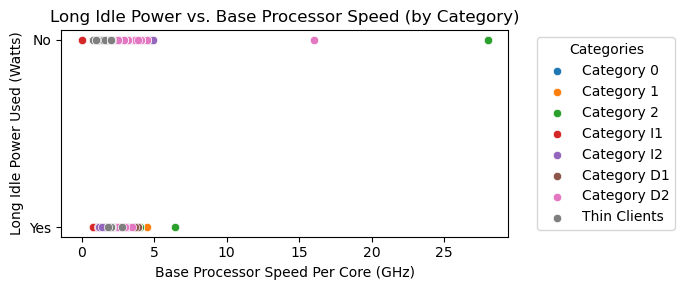

In [146]:
def plot_scatter_idle_vs_speed(data):
    speed_cols = [col for col in data.columns if "Base Processor Speed Per Core" in col]
    idle_cols = [col for col in data.columns if "Long Idle Power Used for Sleep Mode" in col]

    if speed_cols and idle_cols:
        plt.figure(figsize=(7, 3))
        for speed_col, idle_col in zip(speed_cols, idle_cols):
            sns.scatterplot(data=data, x=speed_col, y=idle_col, label=f"{speed_col.split(':')[0]}")
        plt.title('Long Idle Power vs. Base Processor Speed (by Category)')
        plt.xlabel('Base Processor Speed Per Core (GHz)')
        plt.ylabel('Long Idle Power Used (Watts)')
        plt.legend(title='Categories', bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        plt.show()
    else:
        print(f"Required columns not found.")

# Call the function
plot_scatter_idle_vs_speed(df)

# Horizontal Bar Chart - `USB 3.X (10Gb/s) Port Count`

**Description:**

This chart would show the frequency distribution of USB 3.X ports (10Gb/s) across models. It helps in identifying how common high-speed USB ports are and whether they are standard across specific device categories.

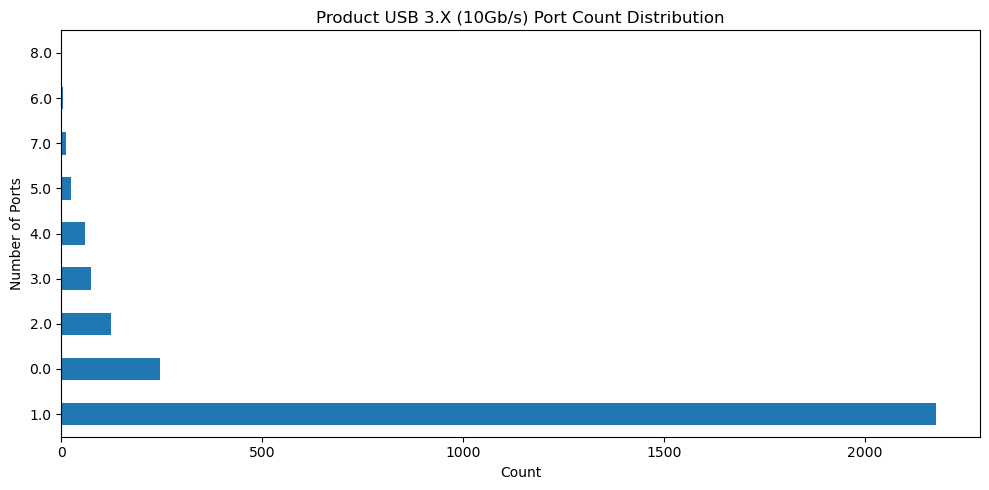

In [134]:
def plot_horizontal_bar_usb(data):
    usb_cols = [col for col in data.columns if 'USB 3.X (10Gb/s) Port Count' in col]

    fig, axes = plt.subplots(nrows=len(usb_cols), ncols=1, figsize=(10, 5 * len(usb_cols)))
    for i, col in enumerate(usb_cols):
        ax = axes[i] if len(usb_cols) > 1 else axes
        port_counts = data[col].value_counts()
        port_counts.plot(kind='barh', ax=ax)
        ax.set_title(f'{col} Distribution')
        ax.set_xlabel('Count')
        ax.set_ylabel('Number of Ports')

    plt.tight_layout()
    plt.show()

# Call the function
plot_horizontal_bar_usb(df)

# Count Plot - `Operating System Name`

**Description:**

A count plot can visualize the frequency of operating systems used in the dataset. This provides insights into OS popularity and might highlight any niche or dominant systems.

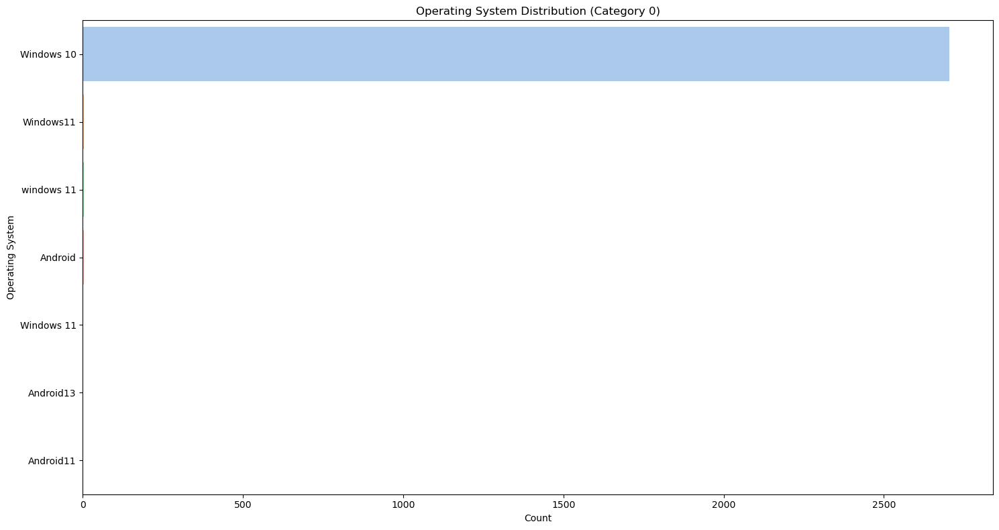

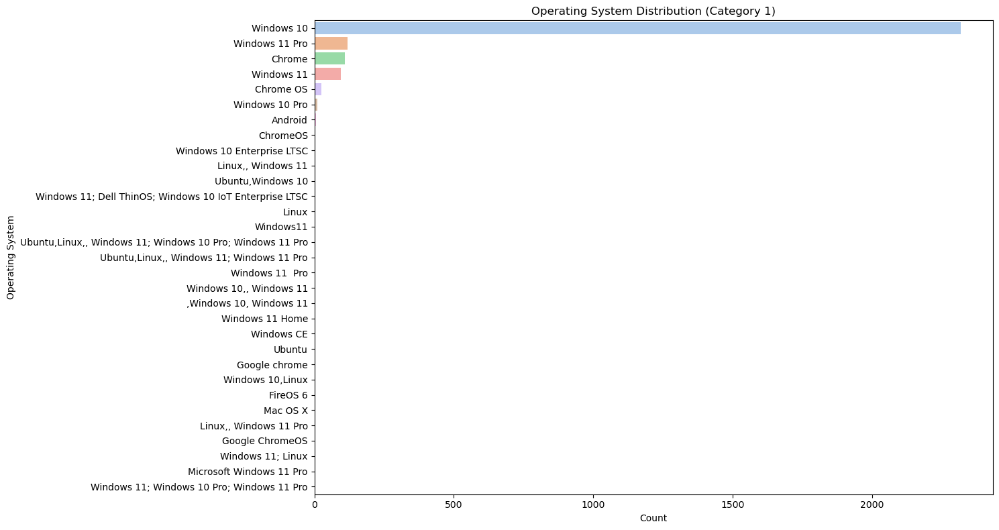

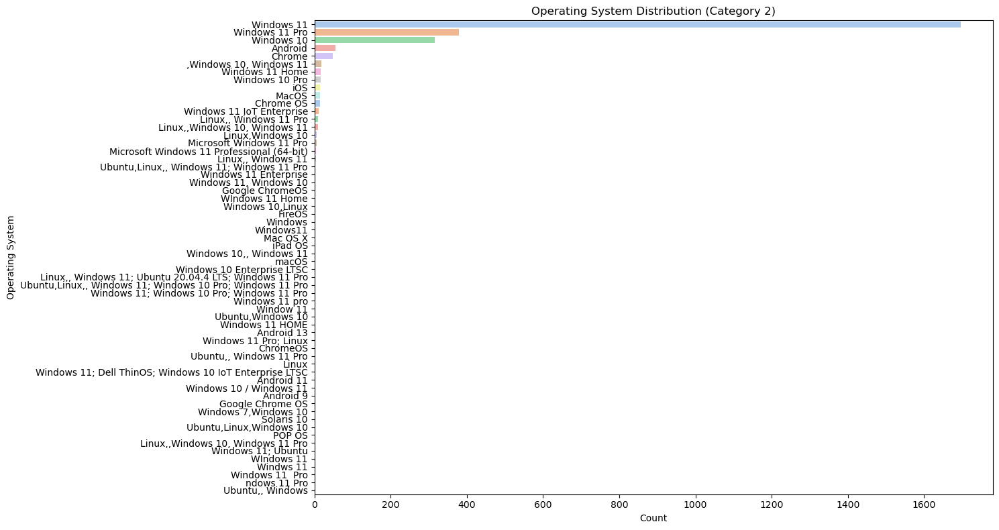

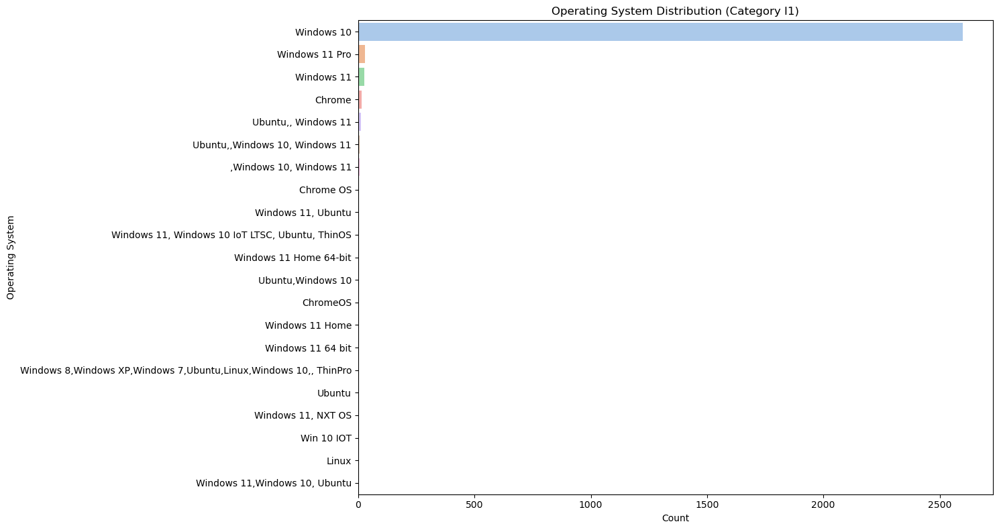

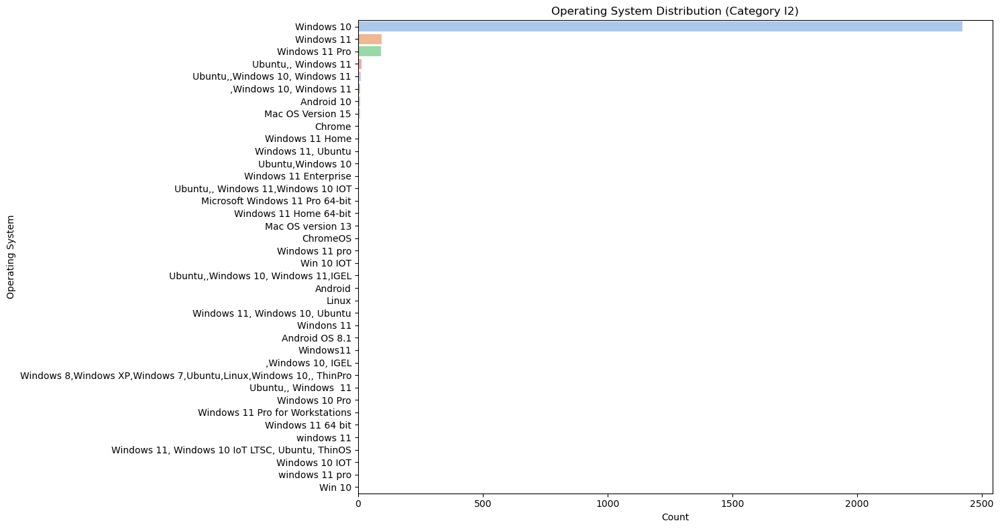

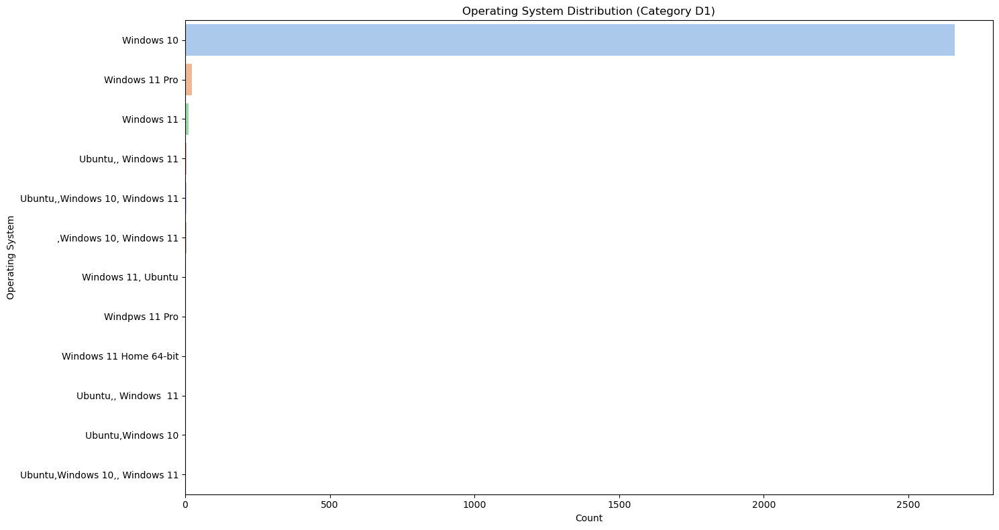

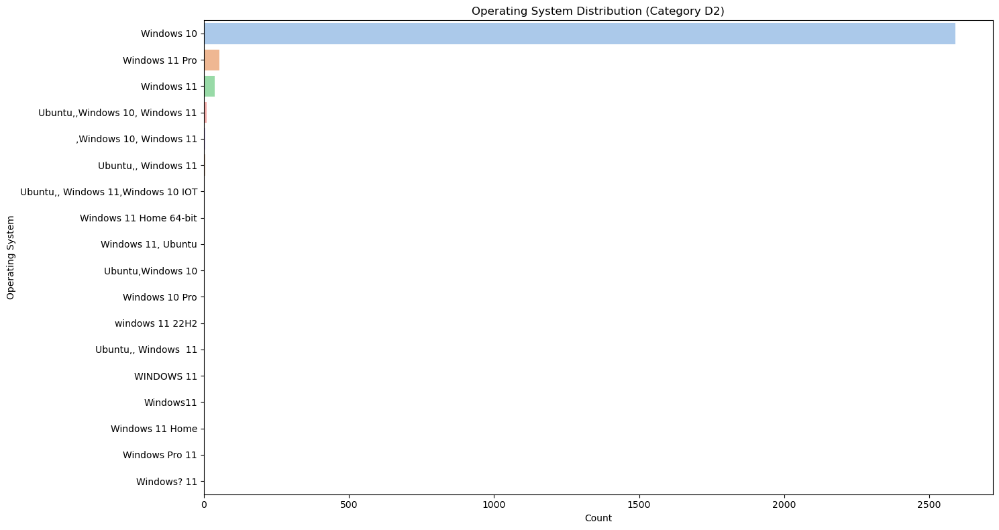

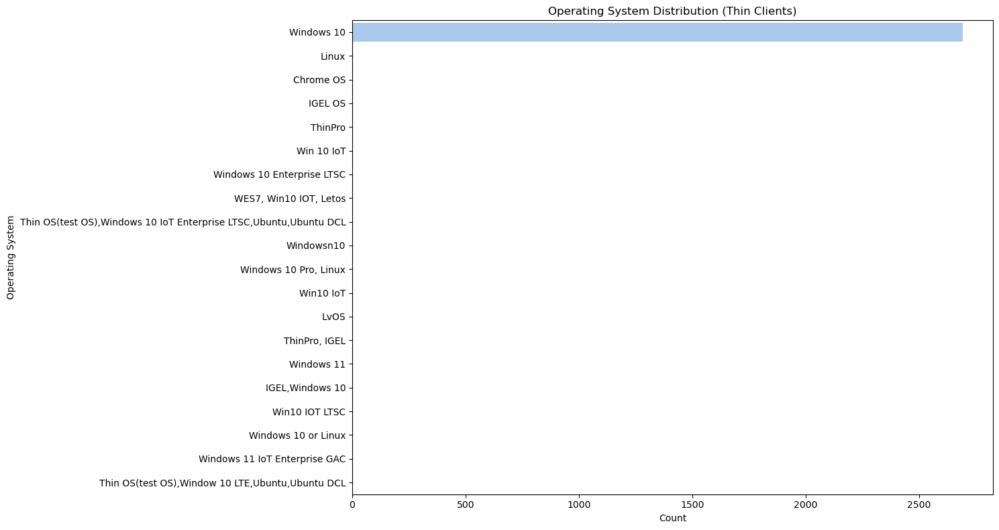

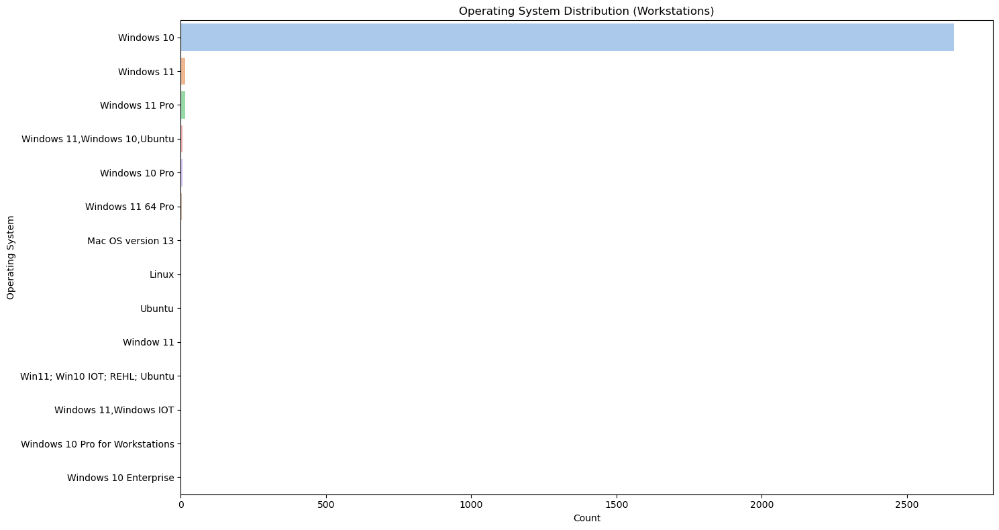

In [158]:
import warnings
warnings.filterwarnings('ignore')

def plot_count_os(data):
    os_cols = [col for col in data.columns if "Operating System Name" in col]

    if os_cols:
        for os_col in os_cols:
            plt.figure(figsize=(15, 8))
            sns.countplot(data=data, y=os_col, order=data[os_col].value_counts().index, palette='pastel')
            plt.title(f'Operating System Distribution ({os_col.split(":")[0]})')
            plt.xlabel('Count')
            plt.ylabel('Operating System')
            plt.tight_layout()
            plt.show()
    else:
        print(f"No Operating System-related columns found.")

# Call the function
plot_count_os(df)


# Line Plot (Time Series or Sorted Index) - `Weighted Power of Model (watts) (Workstations)`

**Description:**

A line plot showing the Weighted Power of Model for workstations over a sorted index (or time if available) reveals energy usage trends. This helps in tracking improvements or inconsistencies in energy efficiency over time or across models.

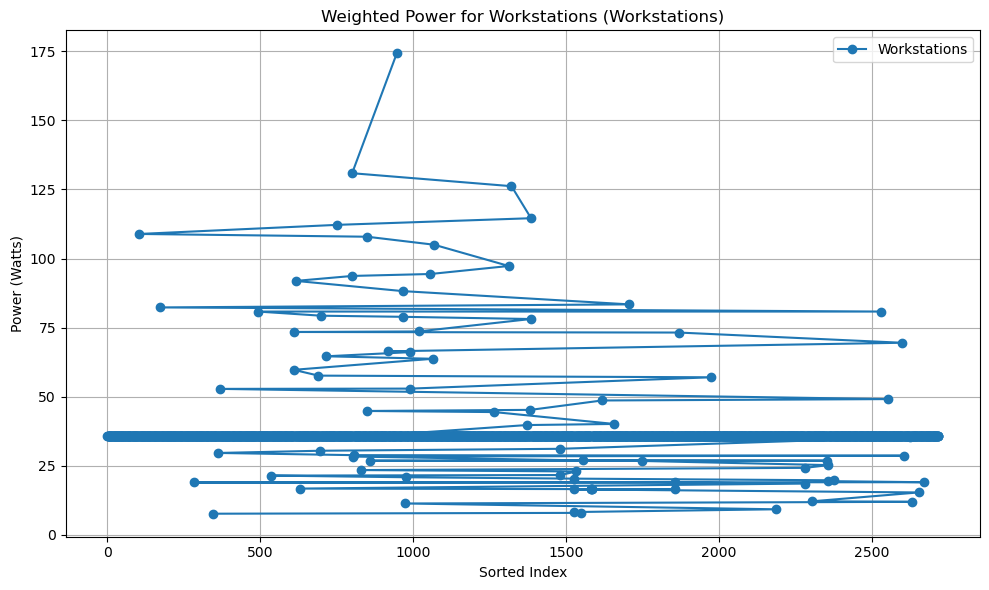

In [160]:
def plot_line_power_workstations(data):
    power_cols = [col for col in data.columns if "Weighted Power of Model" in col]

    if power_cols:
        for power_col in power_cols:
            sorted_data = data.sort_values(by=power_col)
            plt.figure(figsize=(10, 6))
            plt.plot(sorted_data.index, sorted_data[power_col], marker='o', linestyle='-', label=power_col.split(':')[0])
            plt.title(f'Weighted Power for Workstations ({power_col.split(":")[0]})')
            plt.xlabel('Sorted Index')
            plt.ylabel('Power (Watts)')
            plt.grid(True)
            plt.legend()
            plt.tight_layout()
            plt.show()
    else:
        print(f"No columns with Weighted Power information found.")

# Call the function
plot_line_power_workstations(df)

In [35]:
print("Dataset Overview:")
df.info()

Dataset Overview:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2718 entries, 0 to 2717
Columns: 176 entries, ENERGY STAR Unique ID to CB Model Identifier
dtypes: float64(112), int64(1), object(63)
memory usage: 3.6+ MB


In [37]:
df.shape

(2718, 176)

In [38]:
df.columns

Index(['ENERGY STAR Unique ID', 'ENERGY STAR Partner', 'Brand Name',
       'Model Name', 'Model Number', 'Additional Model Information', 'UPC',
       'Type', 'Touch Screen',
       'Notebooks, Desktops, Integrated Computers, Slate/Tablets, Two-in-one Notebooks, and Portable All-in-ones Category for TEC (Typical Energy Consumption) Criteria',
       ...
       'Workstations: Short Idle (watts)',
       'Workstations: Weighted Power of Model (watts)',
       'Sleep Mode Default Time Upon Shipment (min.)',
       'Display Sleep Mode Default Time Upon Shipment (min.)',
       'WOL (Wake on LAN) From Sleep',
       'Will the Speed of Any Active 1 GB/s or Higher Ethernet Network Links be Reduced to Less Than 1 GB/s When Transitioning to Sleep or Off Mode?',
       'Date Available On Market', 'Date Certified', 'Markets',
       'CB Model Identifier'],
      dtype='object', length=176)

In [41]:
df.isnull().sum().sum()

364644

In [42]:
df.head()

,ENERGY STAR Unique ID,ENERGY STAR Partner,Brand Name,Model Name,Model Number,Additional Model Information,UPC,Type,Touch Screen,"Notebooks, Desktops, Integrated Computers, Slate/Tablets, Two-in-one Notebooks, and Portable All-in-ones Category for TEC (Typical Energy Consumption) Criteria",...,Workstations: Short Idle (watts),Workstations: Weighted Power of Model (watts),Sleep Mode Default Time Upon Shipment (min.),Display Sleep Mode Default Time Upon Shipment (min.),WOL (Wake on LAN) From Sleep,Will the Speed of Any Active 1 GB/s or Higher Ethernet Network Links be Reduced to Less Than 1 GB/s When Transitioning to Sleep or Off Mode?,Date Available On Market,Date Certified,Markets,CB Model Identifier
0,3722040,Apple Inc.,Apple,MacBook Pro 16-inch (M4 Max),A3186,",MX2V3,; ,MX2W3,; ,MX303,; ,MX313,; ,Z1FP,; ,Z...",195949868528;195949868702;195949868979;1959498...,Notebook,Yes,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,10/30/2024,09/27/2024,United States,ES_1023756_A3186_103020242022242_3599890
1,3722039,Apple Inc.,Apple,MacBook Pro 16-inch (M4 Max),A3186,",MX2V3,; ,MX303,",NaN,Notebook,Yes,2,...,NaN,NaN,NaN,NaN,NaN,NaN,10/30/2024,09/26/2024,United States,ES_1023756_A3186_103020242017109_7591168
2,3722027,Apple Inc.,Apple,MacBook Pro 14-inch (M4 Pro),A3401,",MX2E3,; ,MX2H3,",NaN,Notebook,Yes,2,...,NaN,NaN,NaN,NaN,NaN,NaN,10/30/2024,10/15/2024,United States,ES_1023756_A3401_103020241943313_8266349
3,3722023,Apple Inc.,Apple,MacBook Pro 14-inch (M4 Max),A3185,",MX2G3,; ,MX2K3,",NaN,Notebook,Yes,2,...,NaN,NaN,NaN,NaN,NaN,NaN,10/30/2024,10/15/2024,United States,ES_1023756_A3185_103020241856721_4500400
4,3722009,Apple Inc.,Apple,Mac mini (M4 Pro),A3239,NaN,195950148404;195950148428;195950148466;1959501...,Desktop,No,Desktop I2 or Integrated Desktop 2,...,NaN,NaN,10.0,10.0,Shipped Enabled Under All Conditions,Yes,10/29/2024,10/22/2024,"United States, Switzerland, Taiwan, Japan, Canada",ES_1023756_A3239_10292024140557_80224651


In [43]:
# Step 2: Cleaning the Data
# Columns to drop (placeholders, identifiers, or descriptive text)
columns_to_remove = [
    "CB Model Identifier", "Markets", "Date Available On Market", "Date Certified", "ENERGY STAR Unique ID",
    "Will the Speed of Any Active 1 GB/s or Higher Ethernet Network Links be Reduced to Less Than 1 GB/s When Transitioning to Sleep or Off Mode?"
]
df = df.drop(columns=columns_to_remove, errors='ignore')

In [44]:
# Fill missing values for numerical columns with median
numerical_columns = df.select_dtypes(include=[np.number]).columns.tolist()
print(df[numerical_columns].isna().sum())


# Fill missing values for categorical columns with mode
categorical_columns = df.select_dtypes(include=['object', 'category']).columns.tolist()
print(df[categorical_columns].isna().sum())


Category 0: Base Processor Speed Per Core (GHz)         2707
Category 0: Physical CPU Cores (count)                  2707
Category 0: System Memory (GB)                          2700
Category 0: Graphics Category                           2718
Category 0: Off Mode (watts)                            2701
                                                        ... 
Workstations: Long Idle (watts)                         2636
Workstations: Short Idle (watts)                        2636
Workstations: Weighted Power of Model (watts)           2637
Sleep Mode Default Time Upon Shipment (min.)             120
Display Sleep Mode Default Time Upon Shipment (min.)     117
Length: 112, dtype: int64
ENERGY STAR Partner                                                                                                                                                   0
Brand Name                                                                                                                             

In [45]:
df[numerical_columns] = df[numerical_columns].fillna(df[numerical_columns].median())

for col in categorical_columns:
    df[col] = df[col].fillna(df[col].mode()[0])

In [47]:
# Re-check missing values
print("\nMissing Values After Cleaning:\n", df.isnull().sum())


Missing Values After Cleaning:
 ENERGY STAR Partner                                     0
Brand Name                                              0
Model Name                                              0
Model Number                                            0
Additional Model Information                            0
                                                       ..
Workstations: Short Idle (watts)                        0
Workstations: Weighted Power of Model (watts)           0
Sleep Mode Default Time Upon Shipment (min.)            0
Display Sleep Mode Default Time Upon Shipment (min.)    0
WOL (Wake on LAN) From Sleep                            0
Length: 170, dtype: int64


In [51]:
df[numerical_columns].describe().T

,count,mean,std,min,25%,50%,75%,max
Category 0: Base Processor Speed Per Core (GHz),2718.0,1.301913,0.058411,1.0,1.30,1.30,1.30,3.8
Category 0: Physical CPU Cores (count),2718.0,7.999264,0.148602,2.0,8.00,8.00,8.00,10.0
Category 0: System Memory (GB),2718.0,8.016777,0.709625,1.6,8.00,8.00,8.00,32.0
Category 0: Graphics Category,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Category 0: Off Mode (watts),2718.0,0.400258,0.018893,0.1,0.40,0.40,0.40,0.9
...,...,...,...,...,...,...,...,...
Workstations: Long Idle (watts),2718.0,53.167550,10.467208,3.2,52.50,52.50,52.50,279.6
Workstations: Short Idle (watts),2718.0,56.581126,10.604255,14.1,55.85,55.85,55.85,297.0
Workstations: Weighted Power of Model (watts),2718.0,36.204746,6.557598,7.6,35.80,35.80,35.80,174.3
Sleep Mode Default Time Upon Shipment (min.),2718.0,14.650110,9.248865,0.0,9.00,10.00,25.00,30.0


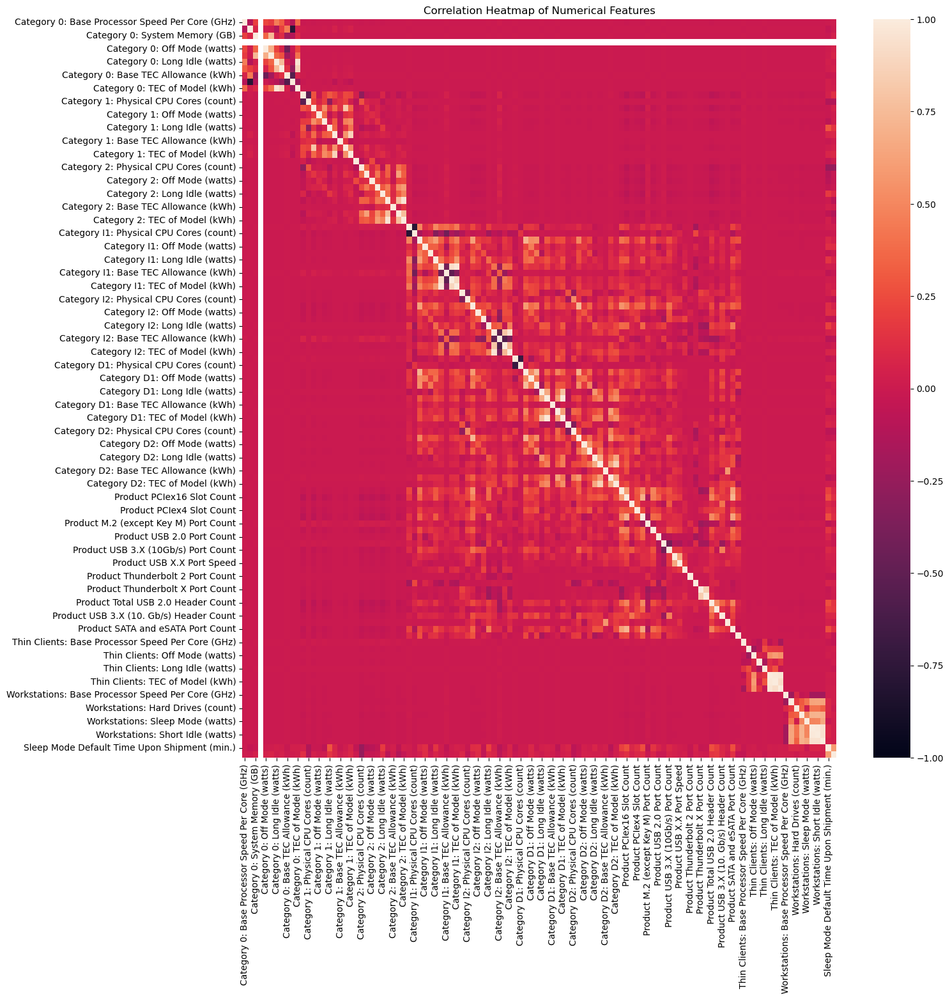

In [59]:
# Correlation Heatmap
plt.figure(figsize=(15, 15))
correlation_matrix = df[numerical_columns].corr()
sns.heatmap(correlation_matrix, fmt=".2f", vmin=-1, vmax=1)
plt.title("Correlation Heatmap of Numerical Features")
plt.show()

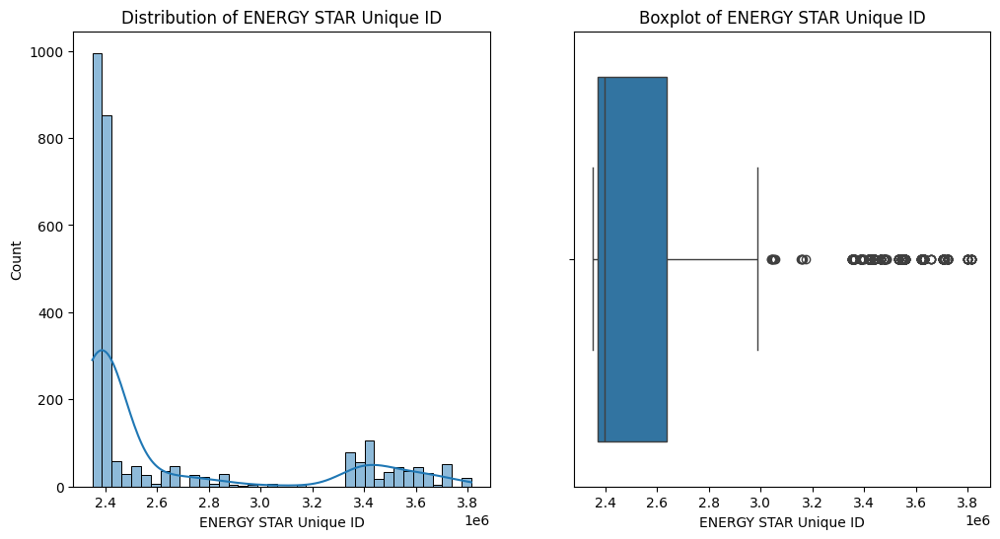

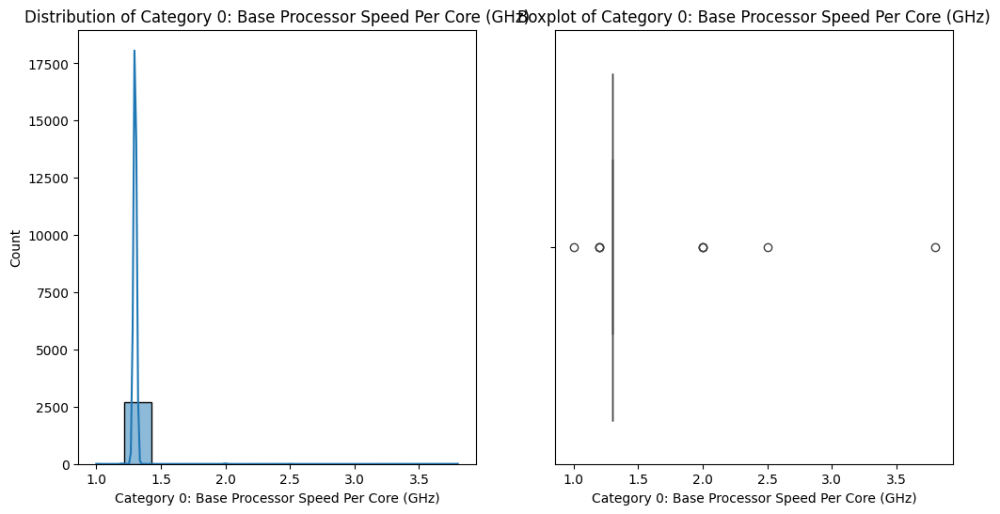

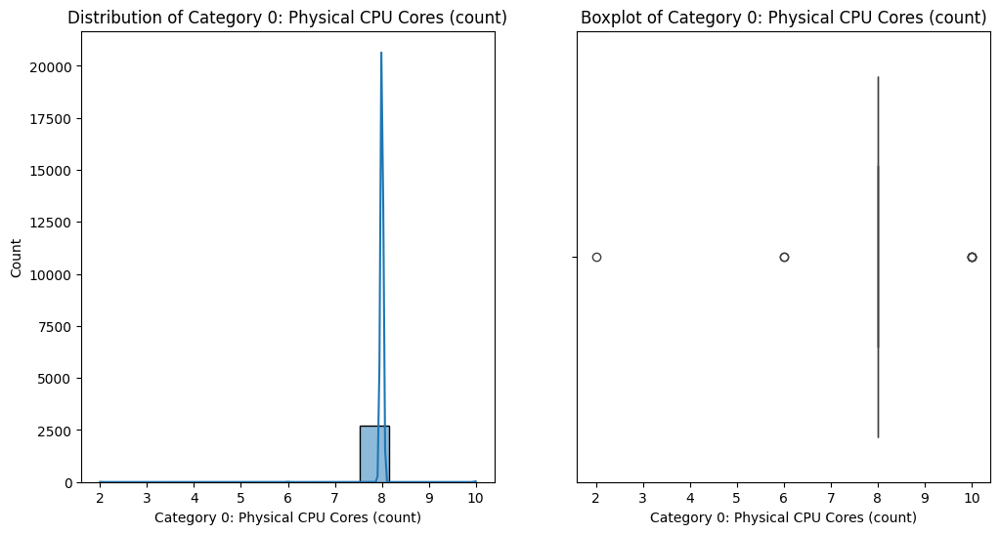

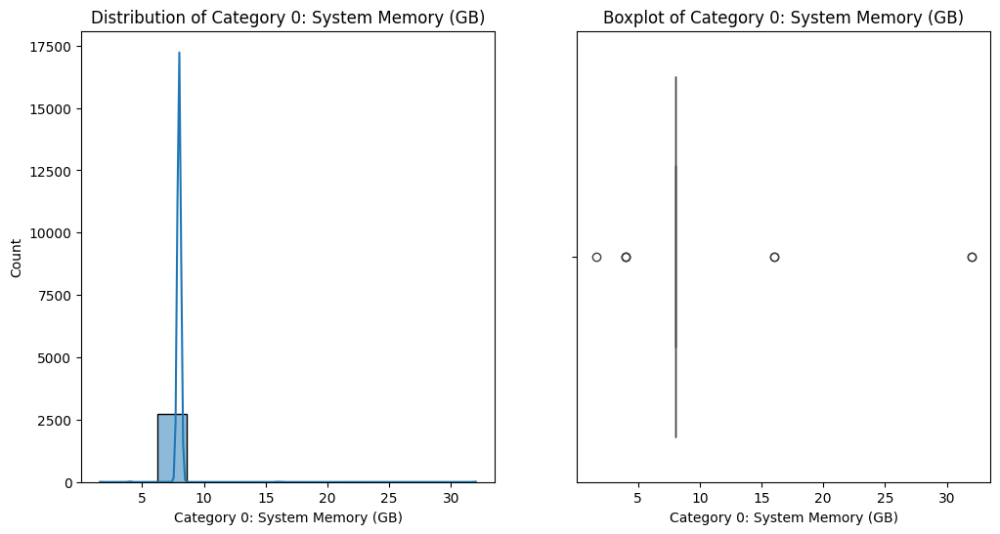

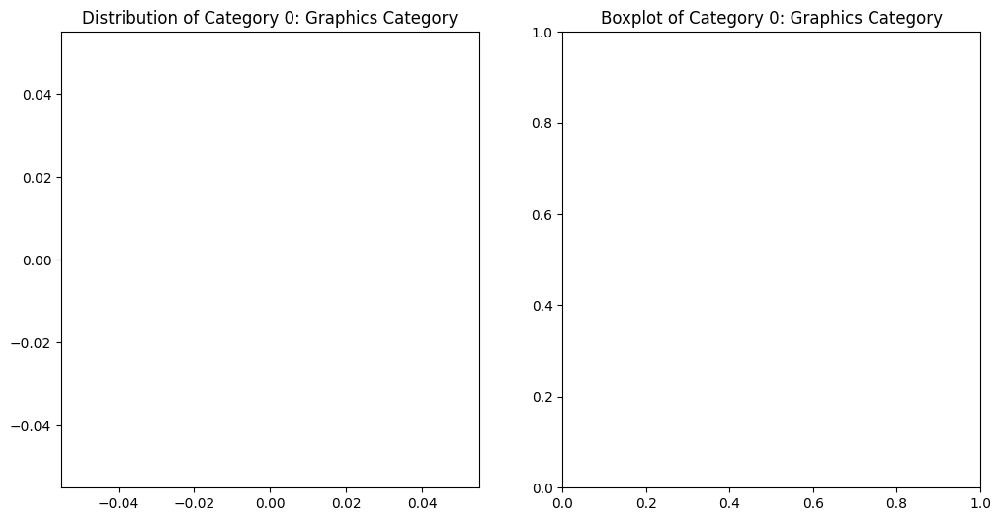

...

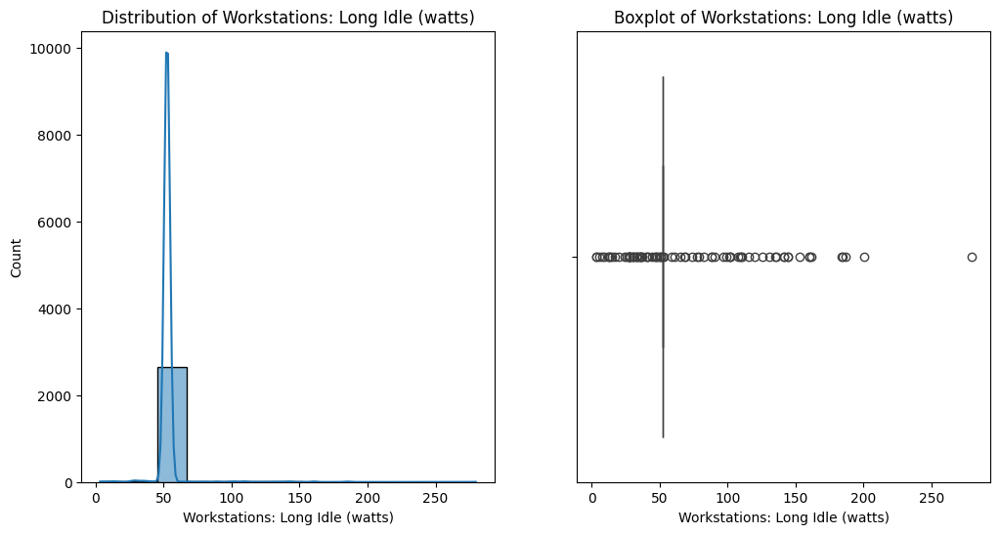

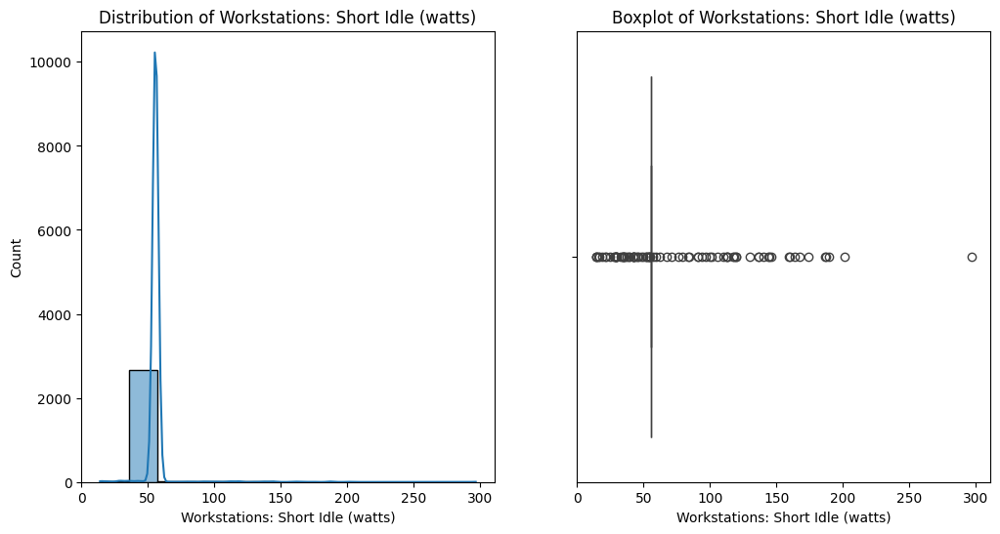

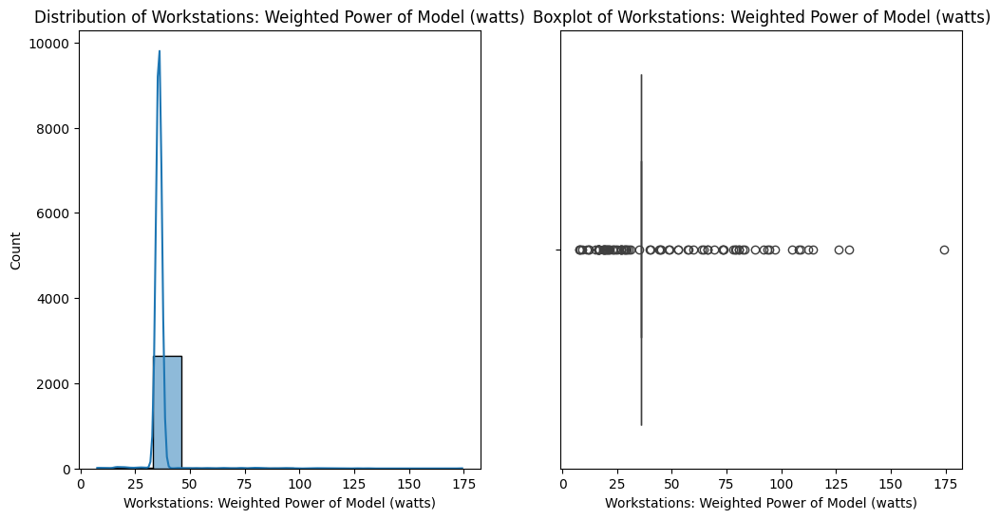

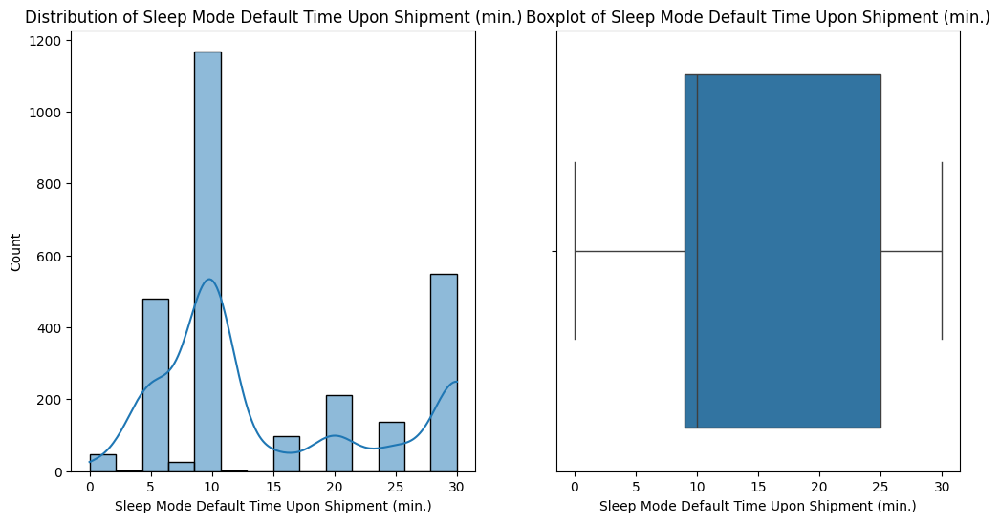

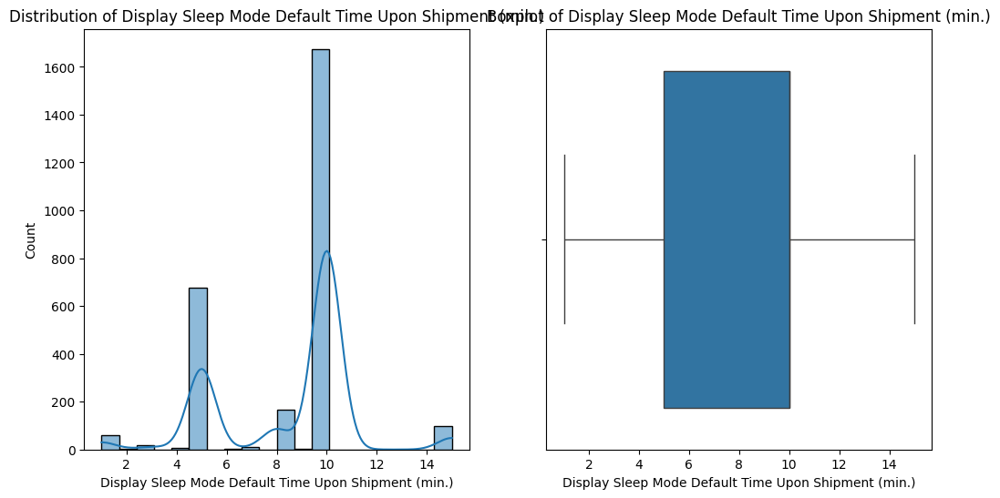

In [12]:
# Visualizing distributions and outliers
for col in numerical_columns:
    try:
        # Drop NaN values for the column
        column_data = df[col].dropna()
        
        # Ensure the column contains only numeric data
        if pd.api.types.is_numeric_dtype(column_data) and column_data.apply(lambda x: isinstance(x, (int, float))).all():
            plt.figure(figsize=(12, 6))
            
            # Distribution Plot
            plt.subplot(1, 2, 1)
            sns.histplot(column_data, kde=True)
            plt.title(f"Distribution of {col}")
            
            # Boxplot
            plt.subplot(1, 2, 2)
            sns.boxplot(x=column_data)
            plt.title(f"Boxplot of {col}")
            
            plt.show()
        else:
            print(f"Skipping non-numeric or invalid column: {col}")
    except Exception as e:
        print(f"Error while processing column {col}: {e}")



Value Counts for ENERGY STAR Partner:
 ENERGY STAR Partner
Lenovo Group Limited                         684
ASUSTeK Computer Inc.                        459
HP Inc.                                      374
Dell Inc.                                    246
Acer Incorporated                            190
                                            ... 
TRUE Distribution & Sales Company Limited      1
Emotions Steam Corp                            1
Wakari Solutions SL                            1
Rangee GmbH                                    1
SNS Network (M) Sdn Bhd                        1
Name: count, Length: 74, dtype: int64


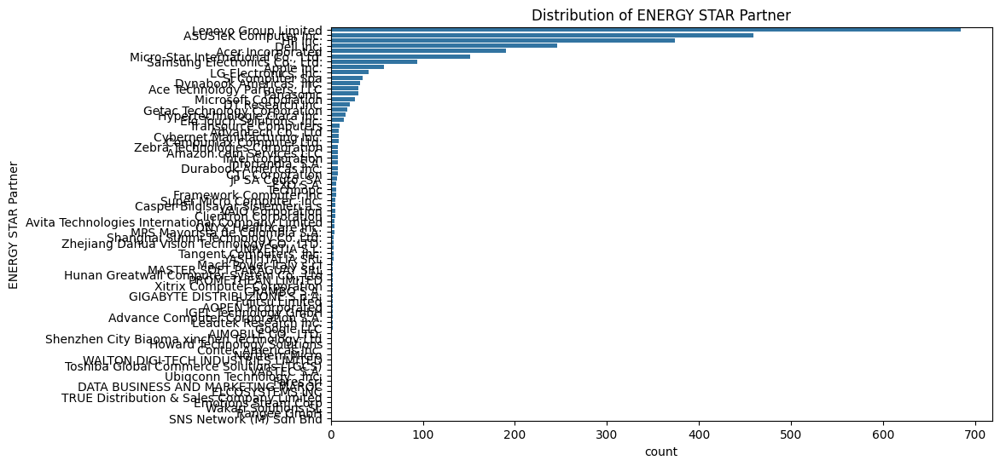


Value Counts for Brand Name:
 Brand Name
Lenovo                          684
ASUS                            459
HP                              374
DELL                            246
Acer                            188
                               ... 
TRUE                              1
Dahua                             1
Samsung Electronics Co.,Ltd.      1
Howard Technology Solutions       1
JOI                               1
Name: count, Length: 90, dtype: int64


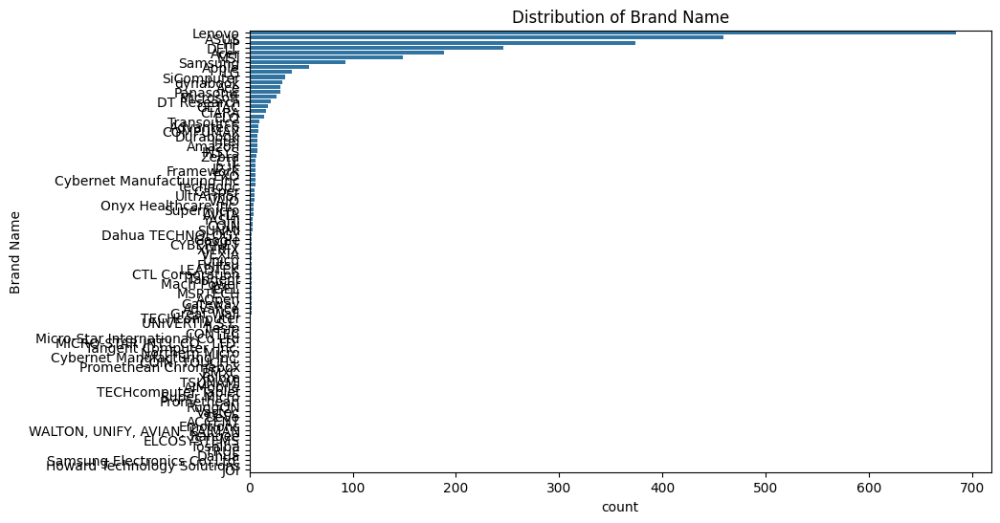


Value Counts for Model Name:
 Model Name
D17S                         11
Ace Vision                    9
D15U                          8
P112F                         7
P90F                          7
                             ..
UX6404V Series                1
N22Q18                        1
M1505Y Series                 1
M1405Y Series                 1
IdeaCentre Gaming5 17IAB7     1
Name: count, Length: 2335, dtype: int64


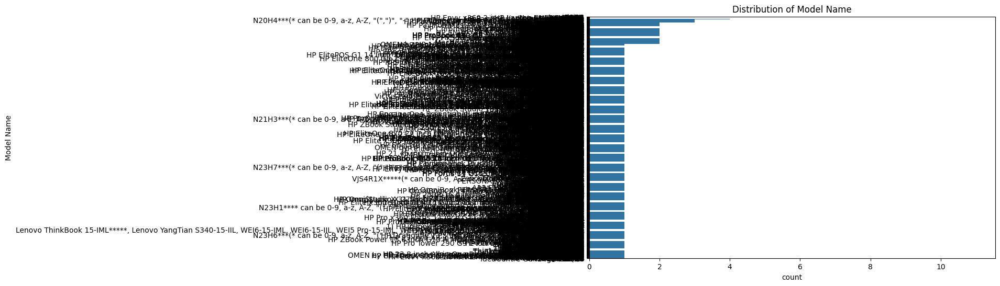


Value Counts for Model Number:
 Model Number
Zbook               5
OptiPlex 3000 TC    3
ESY15I1D-C          3
81BF                3
K2.*#.##.##         3
                   ..
Latitude 5540       1
M3504Y              1
Latitude 3540       1
16U70R-*            1
90T0                1
Name: count, Length: 2620, dtype: int64


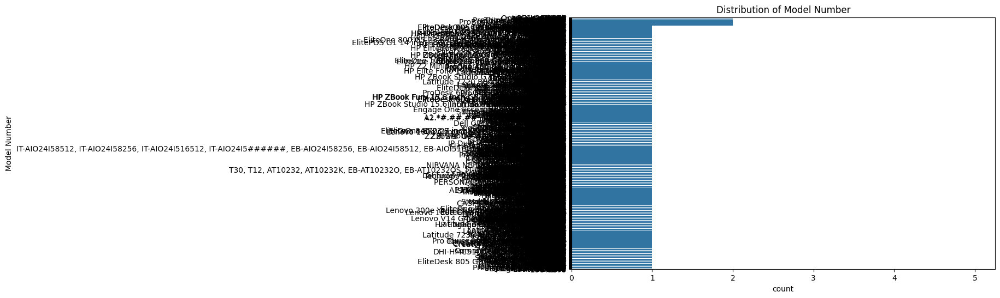


Value Counts for Additional Model Information:
 Additional Model Information
,,"*"= 0-9, A-Z or blank                                                                                                                           918
,,(* can be 0-9, A-Z or blank)                                                                                                                       4
,,(* = 0-9, A-Z or blank)                                                                                                                            3
,,*=0-9, A-Z or blank                                                                                                                                3
,,*= 0-9, A-Z or blank                                                                                                                               3
                                                                                                                                                  ... 
Productiva One,G

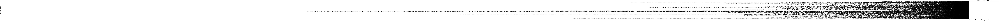


Value Counts for UPC:
 UPC
5604008017449                                                                                                                                                                                                                                                                                                                           2056
824142364857                                                                                                                                                                                                                                                                                                                               4
62863491254006                                                                                                                                                                                                                                                                                                    

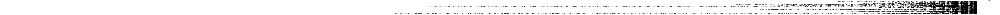


Value Counts for Type:
 Type
Notebook                        1798
Desktop                          419
Integrated Desktop               189
Slate/Tablet                     158
Workstation                       88
Thin Client                       24
Two-In-One Notebook               17
Mobile Workstation                16
Integrated Thin Client             7
Portable All-In-One Computer       3
Name: count, dtype: int64


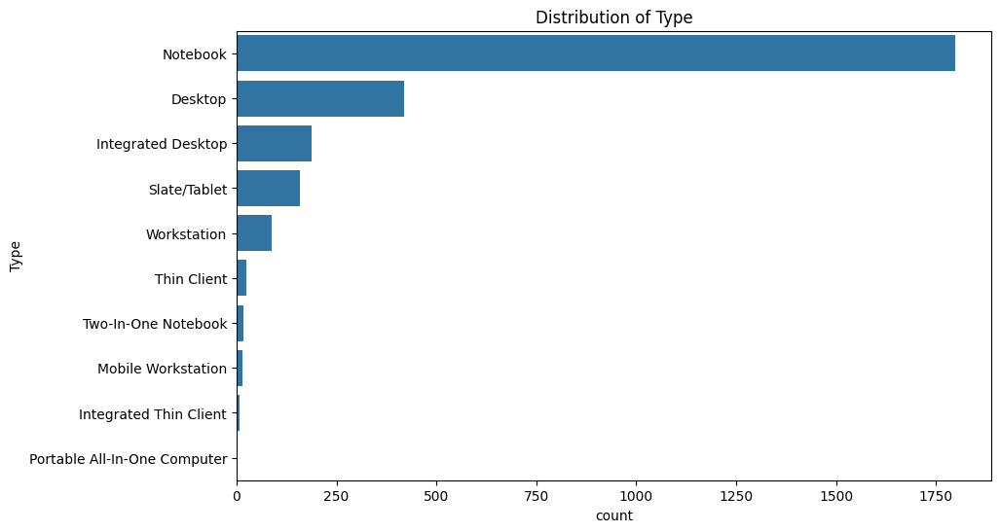


Value Counts for Touch Screen:
 Touch Screen
No     1813
Yes     906
Name: count, dtype: int64


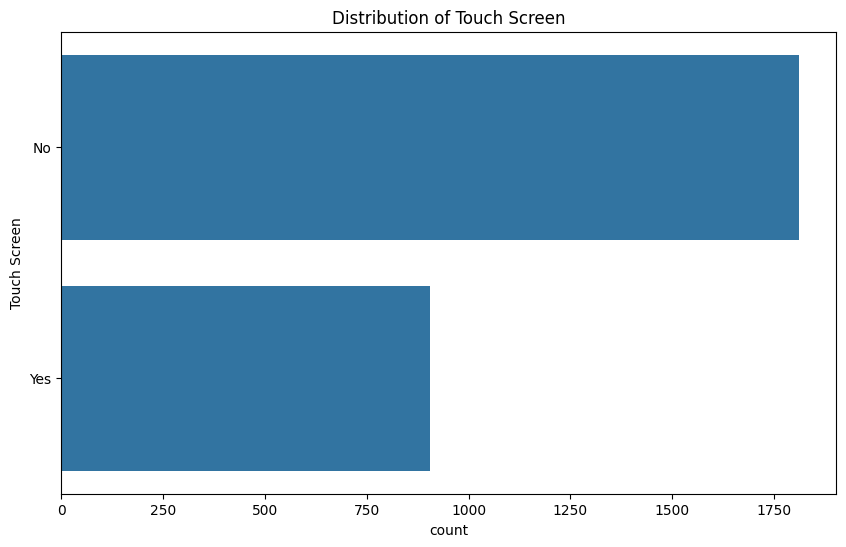


Value Counts for Notebooks, Desktops, Integrated Computers, Slate/Tablets, Two-in-one Notebooks, and Portable All-in-ones Category for TEC (Typical Energy Consumption) Criteria:
 Notebooks, Desktops, Integrated Computers, Slate/Tablets, Two-in-one Notebooks, and Portable All-in-ones Category for TEC (Typical Energy Consumption) Criteria
2                                                                                              1444
1                                                                                               436
Desktop I2 or Integrated Desktop 2                                                              231
2,1                                                                                             213
Desktop I1 or Integrated Desktop 1                                                               87
Desktop D2,Desktop I2 or Integrated Desktop 2                                                    75
Desktop D1,Desktop D2,Desktop I1 or Integrated Desktop 1,Des

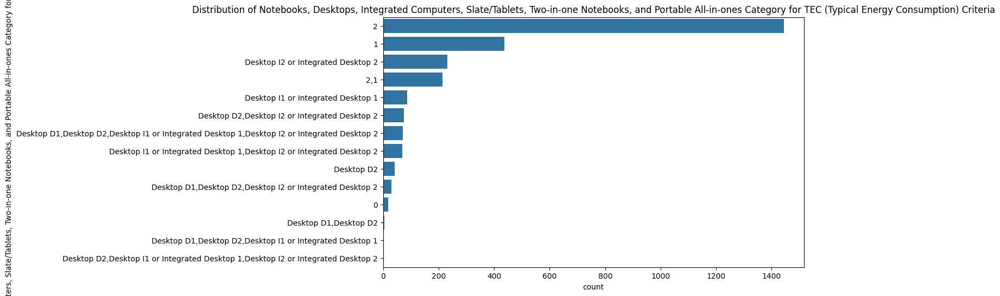


Value Counts for Category 0: Processor Brand:
 Category 0: Processor Brand
Other    2710
Intel       8
AMD         1
Name: count, dtype: int64


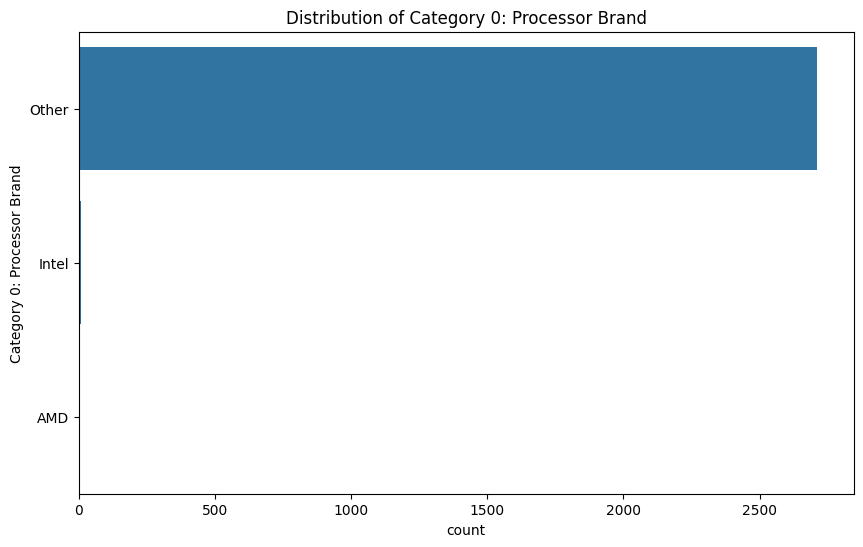


Value Counts for Category 0: Processor Name:
 Category 0: Processor Name
Core i5          2715
Core i3             3
Ryzen 7 7730U       1
Name: count, dtype: int64


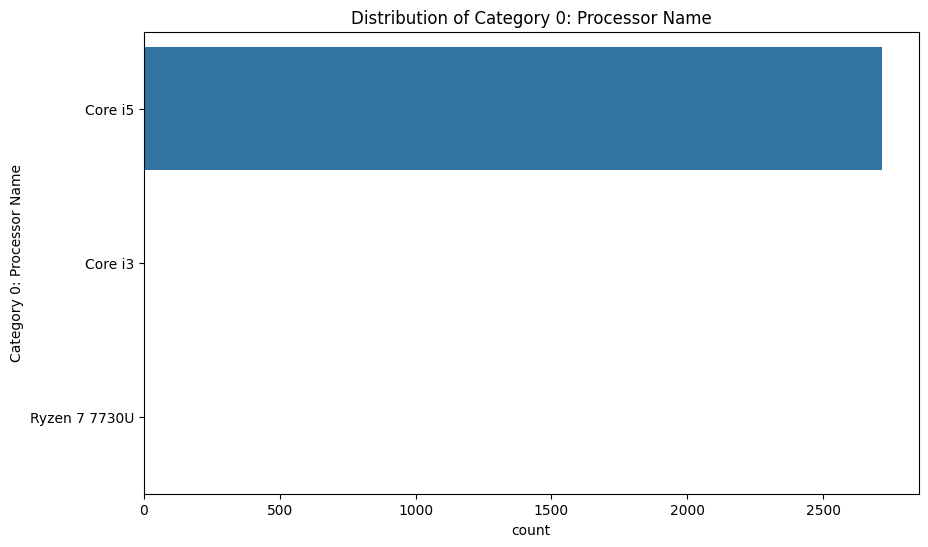


Value Counts for Category 0: Operating System Name:
 Category 0: Operating System Name
Windows 10    2706
Windows11        3
windows 11       3
Android          3
Windows 11       2
Android13        1
Android11        1
Name: count, dtype: int64


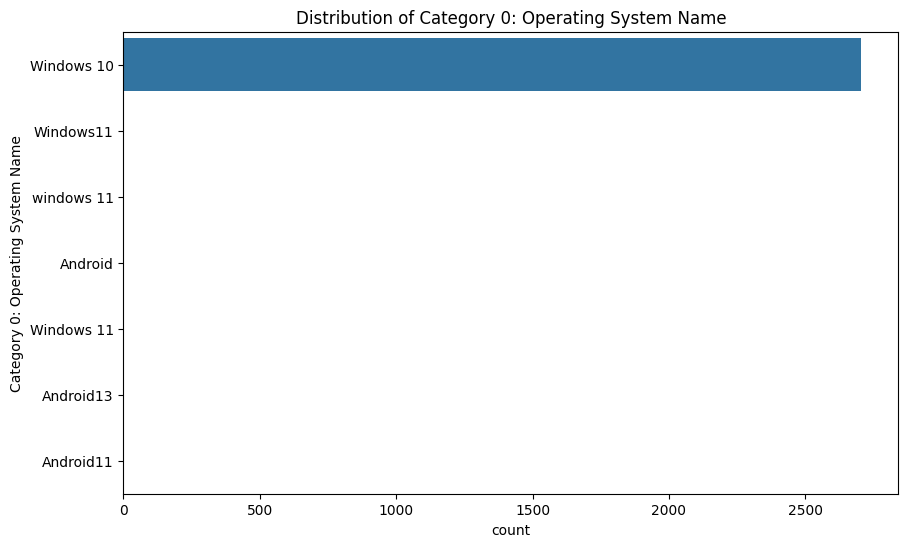


Value Counts for Category 0: Default Low-power Mode:
 Category 0: Default Low-power Mode
Sleep Mode                   2713
Off Mode with Hibernation       6
Name: count, dtype: int64


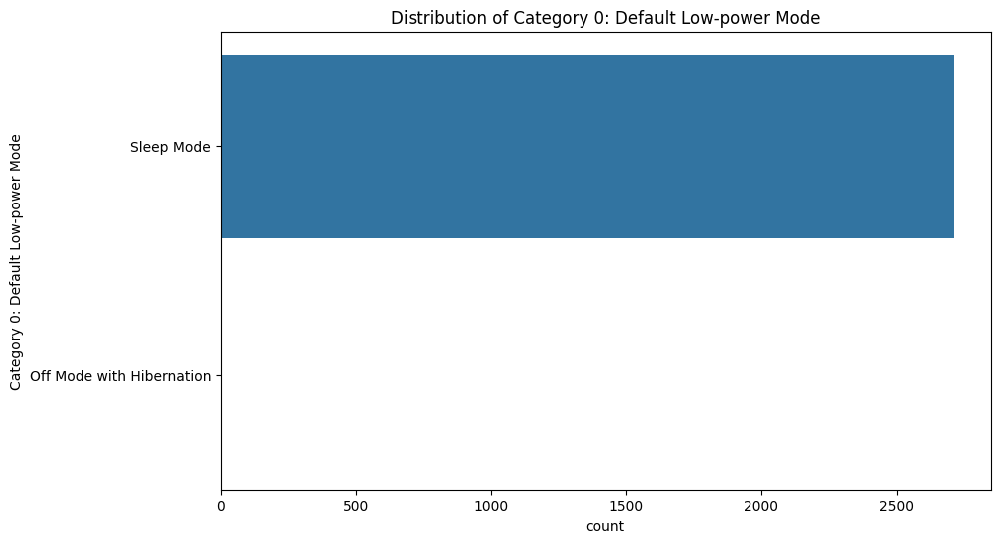


Value Counts for Category 0: Long Idle Power Used for Sleep Mode:
 Category 0: Long Idle Power Used for Sleep Mode
No     2698
Yes      21
Name: count, dtype: int64


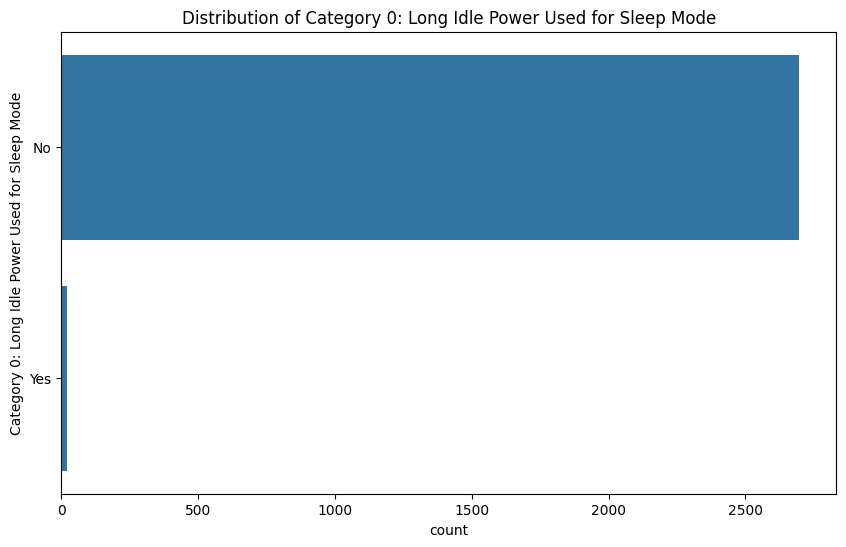


Value Counts for Category 1: Processor Brand:
 Category 1: Processor Brand
Intel    2550
Other     101
AMD        68
Name: count, dtype: int64


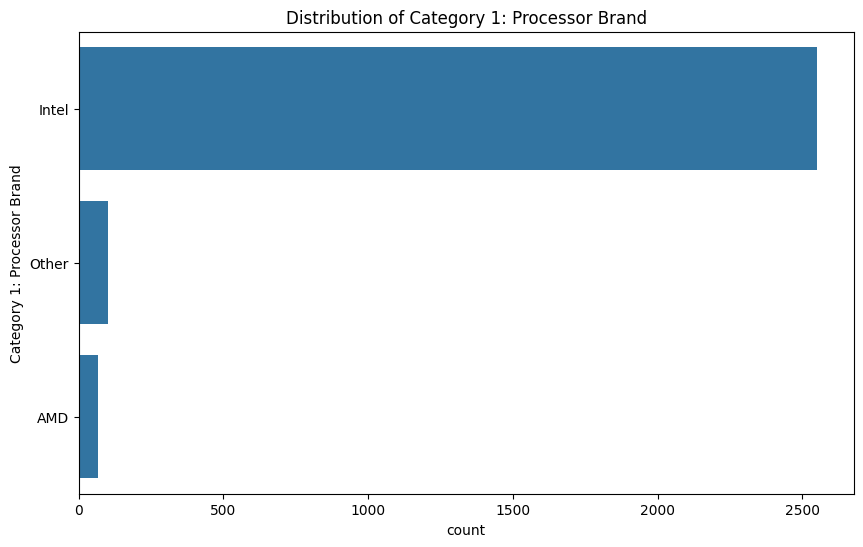


Value Counts for Category 1: Processor Name:
 Category 1: Processor Name
Core i3                                 2172
Core i7                                  116
Pentium                                   51
N200                                      31
Celeron                                   31
                                        ... 
Processor N100                             1
Pentium Silver N5030                       1
13th Gen Intel� Core(TM) i3-1315U          1
A6-9220e                                   1
Intel Pentium Silver N6000 Processor       1
Name: count, Length: 124, dtype: int64


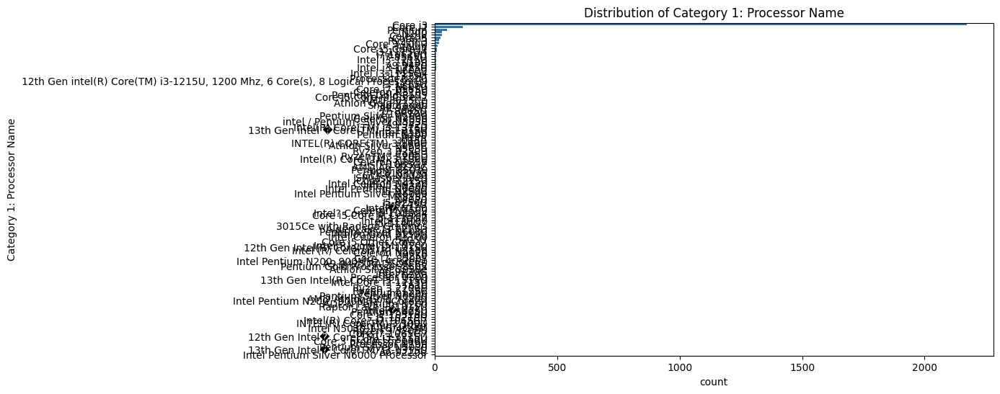


Value Counts for Category 1: Operating System Name:
 Category 1: Operating System Name
Windows 10                                                   2319
Windows 11 Pro                                                119
Chrome                                                        108
Windows 11                                                     95
Chrome OS                                                      25
Windows 10 Pro                                                 11
Android                                                         5
ChromeOS                                                        4
Windows 10 Enterprise LTSC                                      4
Linux,, Windows 11                                              3
Ubuntu,Windows 10                                               3
Windows 11; Dell ThinOS; Windows 10 IoT Enterprise LTSC         2
Linux                                                           2
Windows11                                             

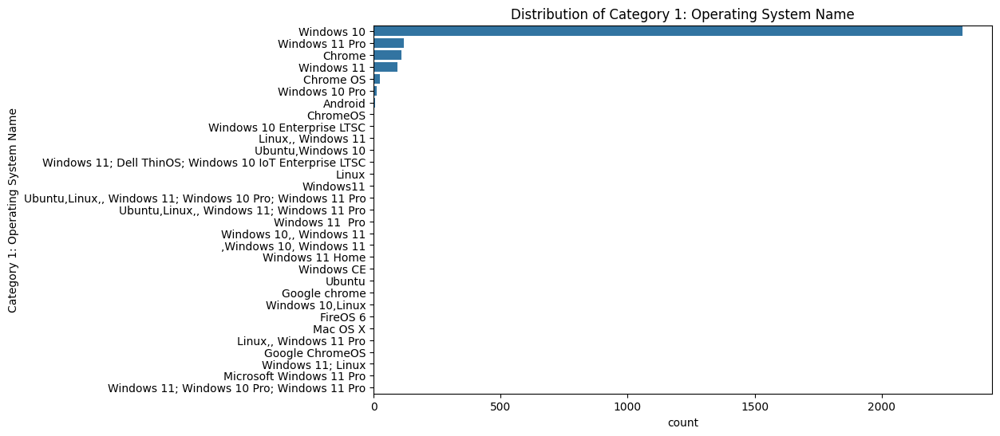


Value Counts for Category 1: Default Low-power Mode:
 Category 1: Default Low-power Mode
Sleep Mode                                        2398
ALPM                                               147
Off Mode with Hibernation                           39
Modern Standby                                      35
Connected Sleep                                     31
Modern Standby Mode                                 25
Connected Modern Standby                            16
Modern standby                                       8
Alternative Low Power Mode (ALPM)                    5
Moldern Standby                                      2
Modern standby mode                                  2
Connected Modern Standby Mode                        2
Connected Sleep(Modern Standby)                      2
Alternated low power mode, default time 10min.       2
modern standby                                       1
Other                                                1
Connected modern standby mode 

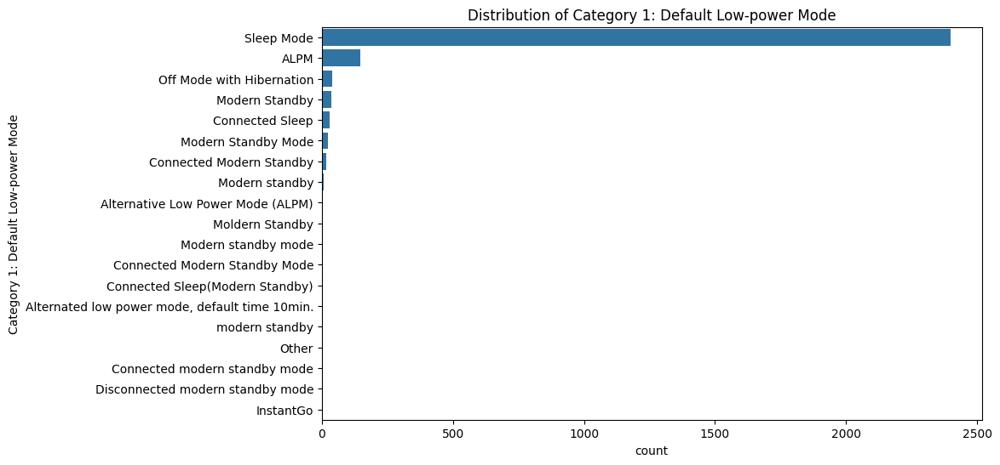


Value Counts for Category 1: Long Idle Power Used for Sleep Mode:
 Category 1: Long Idle Power Used for Sleep Mode
No     2562
Yes     157
Name: count, dtype: int64


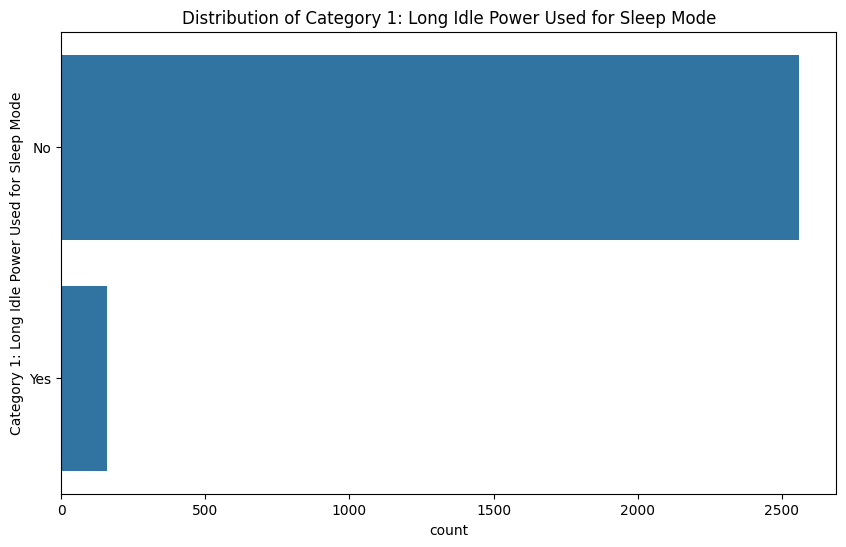


Value Counts for Category 2: Processor Brand:
 Category 2: Processor Brand
Intel    2157
AMD       372
Other     190
Name: count, dtype: int64


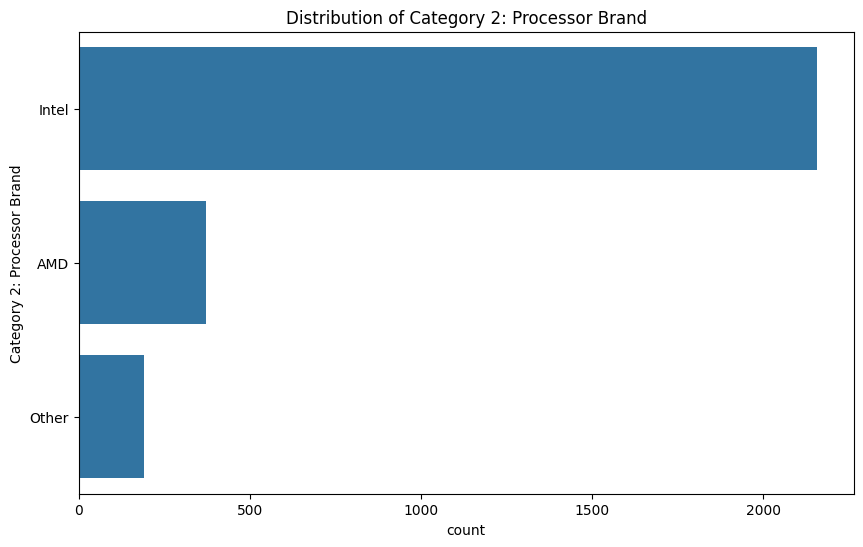


Value Counts for Category 2: Processor Name:
 Category 2: Processor Name
Core i7                                   1695
Ryzen 7                                    227
Core i9                                     66
Core i5                                     42
Core i5,Core i7                             28
                                          ... 
SM6375                                       1
13th Gen Intel� Core(TM) i7 1355U            1
Ryzen 7 7840U                                1
AMD Ryzen 5 7520C with Radeon Graphics       1
Qualcomm  SM6225                             1
Name: count, Length: 320, dtype: int64


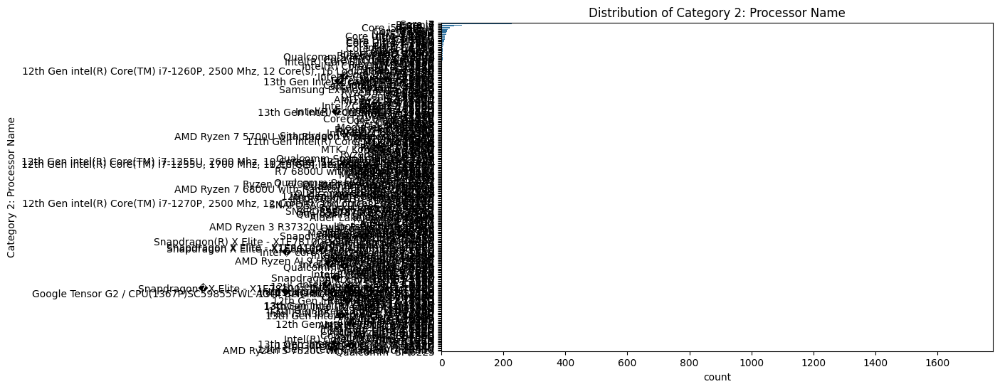


Value Counts for Category 2: Operating System Name:
 Category 2: Operating System Name
Windows 11                                                   1696
Windows 11 Pro                                                380
Windows 10                                                    316
Android                                                        57
Chrome                                                         48
,Windows 10, Windows 11                                        18
Windows 11 Home                                                17
Windows 10 Pro                                                 15
iOS                                                            15
MacOS                                                          15
Chrome OS                                                      14
Windows 11 IoT Enterprise                                      11
Linux,, Windows 11 Pro                                         10
Linux,,Windows 10, Windows 11                         

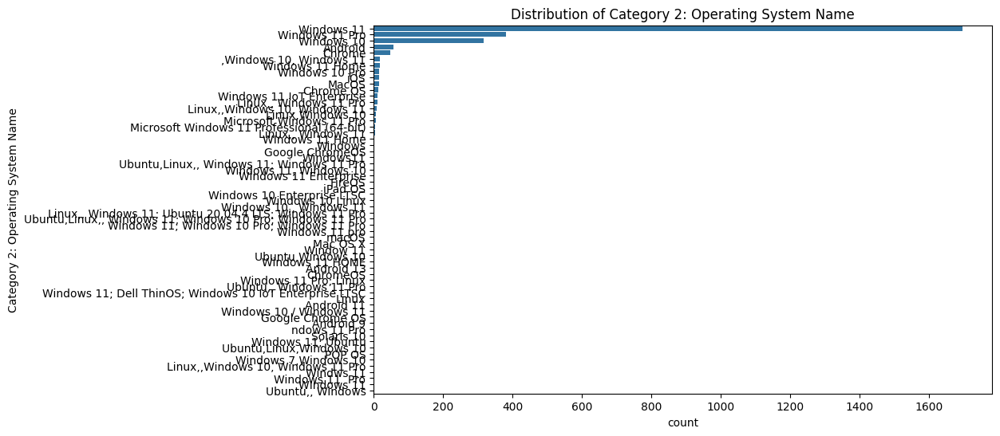


Value Counts for Category 2: Default Low-power Mode:
 Category 2: Default Low-power Mode
ALPM                                               1918
Sleep Mode                                          292
Modern Standby                                      175
Connected Sleep                                     125
Off Mode with Hibernation                            61
Modern Standby Mode                                  60
Connected Modern Standby                             25
Modern standby                                       18
Alternative Low Power Mode (ALPM)                    12
Display off State                                     8
ALPM Mode                                             5
Alternated low power mode, default time 5min.         3
Alternated low power mode, default time 10min.        2
Modern Standby mode                                   2
Connected Sleep(Modern Standby)                       2
Disconnected Modern Standby                           2
Disconnected m

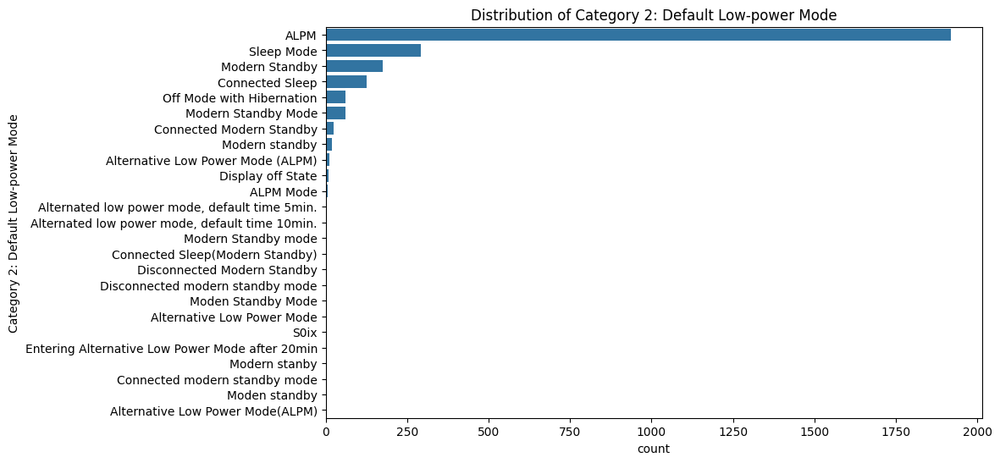


Value Counts for Category 2: Long Idle Power Used for Sleep Mode:
 Category 2: Long Idle Power Used for Sleep Mode
No     2133
Yes     586
Name: count, dtype: int64


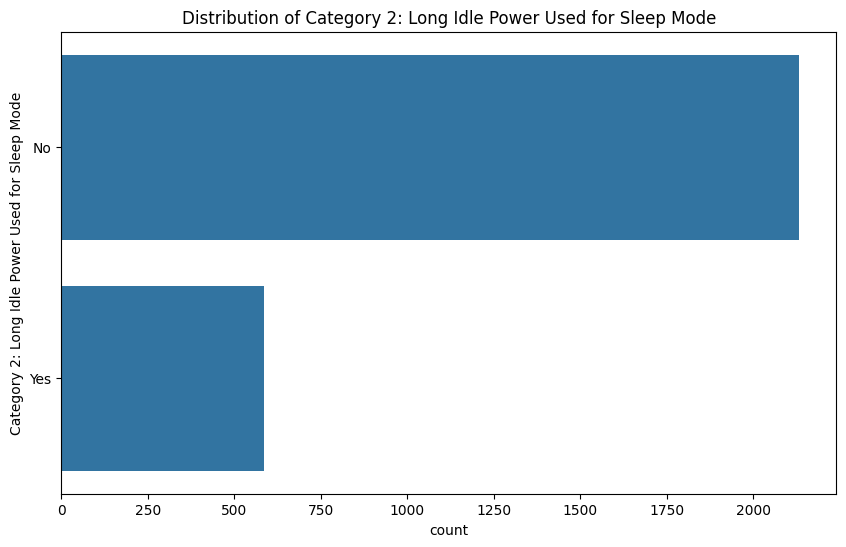


Value Counts for Category I1: Processor Brand:
 Category I1: Processor Brand
Intel    2687
Other      18
AMD        14
Name: count, dtype: int64


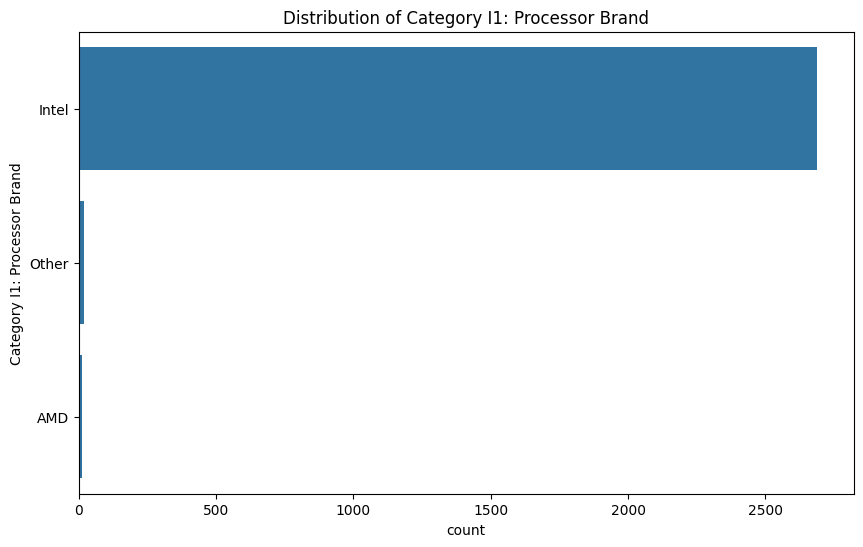


Value Counts for Category I1: Processor Name:
 Category I1: Processor Name
Pentium                           2544
Core i3                             21
Celeron                             20
300                                 13
Core i5                             13
                                  ... 
i5-8365U                             1
Core i7-10610U                       1
Intel(R) Celeron(R) G5920            1
Intel(R) Pentium(R) Gold G6400       1
AMD CPU Ryzen3-3250U                 1
Name: count, Length: 69, dtype: int64


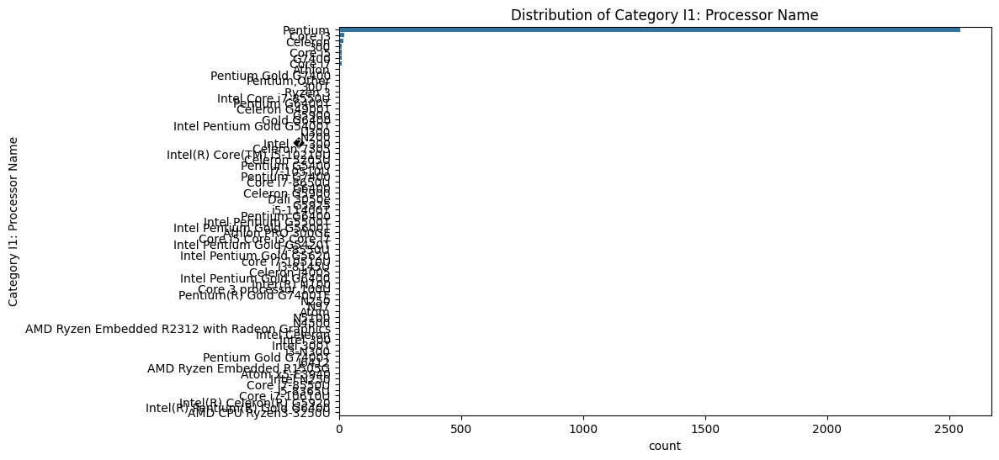


Value Counts for Category I1: Operating System Name:
 Category I1: Operating System Name
Windows 10                                                          2599
Windows 11 Pro                                                        30
Windows 11                                                            26
Chrome                                                                14
Ubuntu,, Windows 11                                                   13
Ubuntu,,Windows 10, Windows 11                                         7
,Windows 10, Windows 11                                                7
Chrome OS                                                              4
Windows 11, Ubuntu                                                     3
Windows 11, Windows 10 IoT LTSC, Ubuntu, ThinOS                        2
Windows 11 Home 64-bit                                                 2
Ubuntu,Windows 10                                                      2
ChromeOS                          

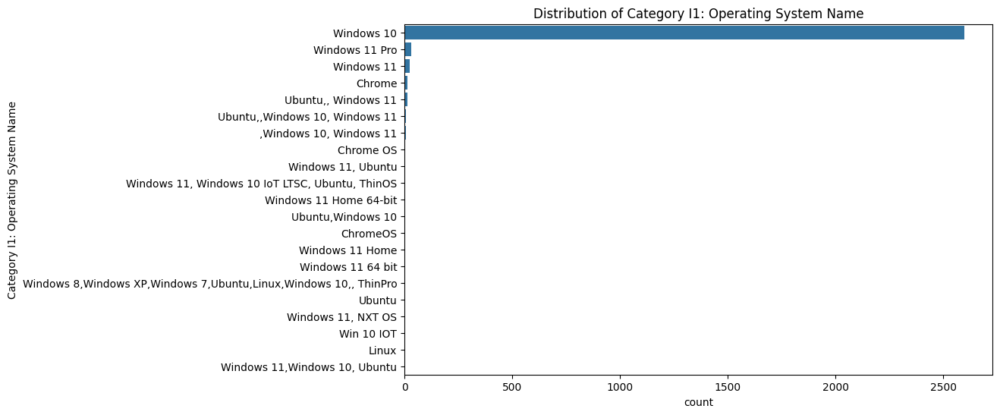


Value Counts for Category I1: Default Low-power Mode:
 Category I1: Default Low-power Mode
Sleep Mode                   2668
Modern Standby                 15
ALPM                           14
Off Mode with Hibernation       8
Connected Sleep                 7
Modern standby                  2
Modern Standby Mode             2
ALPM Mode                       1
Display Sleep Mode              1
modern standby                  1
Name: count, dtype: int64


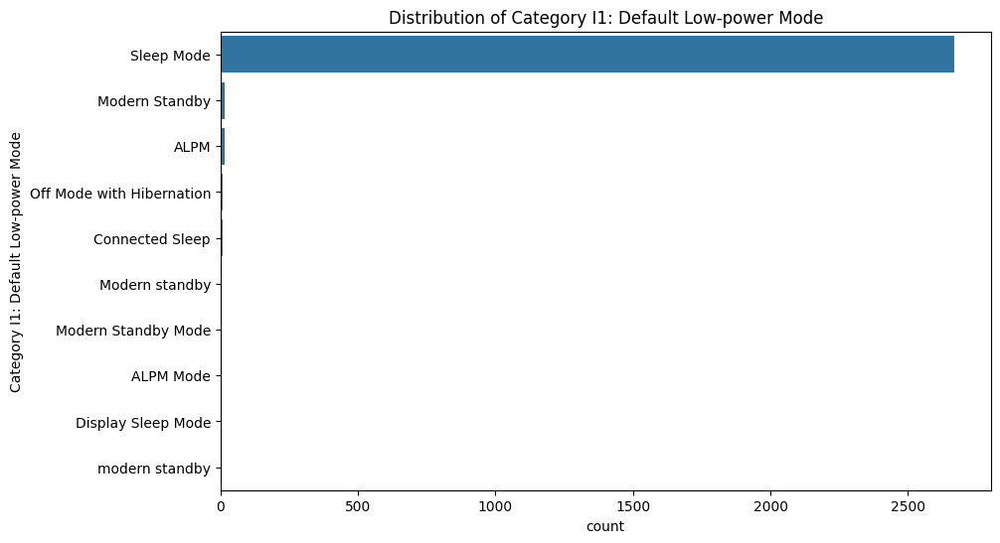


Value Counts for Category I1: Long Idle Power Used for Sleep Mode:
 Category I1: Long Idle Power Used for Sleep Mode
No     2687
Yes      32
Name: count, dtype: int64


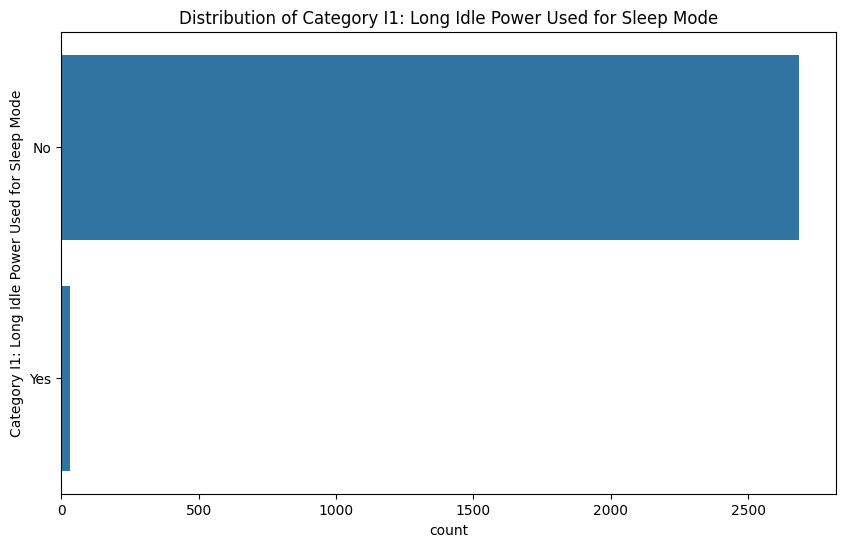


Value Counts for Category I2: Processor Brand:
 Category I2: Processor Brand
Intel    2642
AMD        55
Other      22
Name: count, dtype: int64


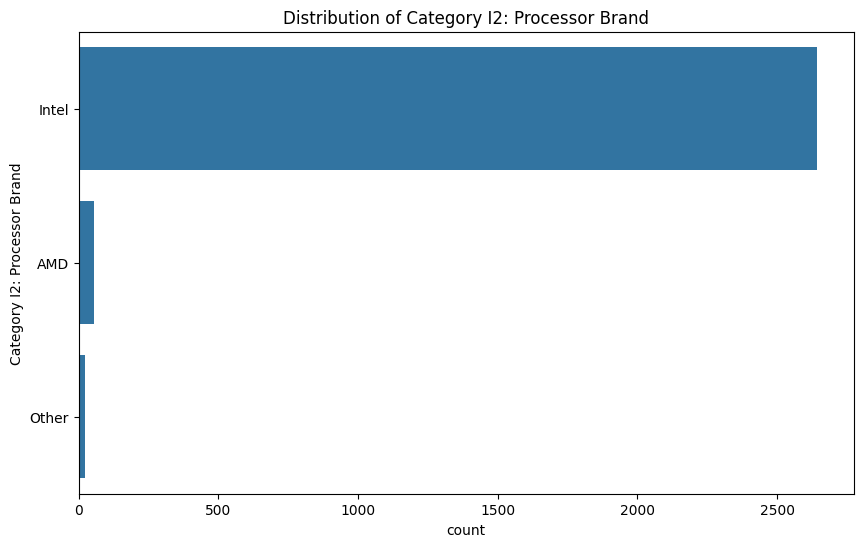


Value Counts for Category I2: Processor Name:
 Category I2: Processor Name
Core i7                                 2405
Core i5                                   52
Core i9                                   39
Ryzen 7                                   21
Ryzen 5                                   15
                                        ... 
11th Gen Intel(R) Core (TM) i5-11500       1
Ryzen Embedded V2546                       1
I9-14900K                                  1
Core Ultra                                 1
I9-12900K                                  1
Name: count, Length: 113, dtype: int64


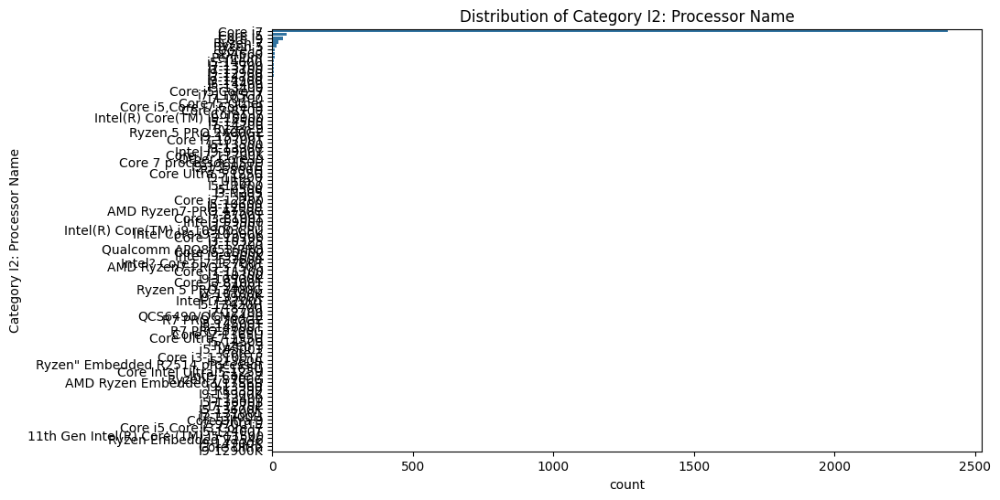


Value Counts for Category I2: Operating System Name:
 Category I2: Operating System Name
Windows 10                                                          2422
Windows 11 Pro                                                        95
Windows 11                                                            94
Ubuntu,, Windows 11                                                   15
Ubuntu,,Windows 10, Windows 11                                        11
,Windows 10, Windows 11                                               10
Android 10                                                             8
Mac OS Version 15                                                      8
Chrome                                                                 6
Windows 11 Home                                                        5
Windows 11, Ubuntu                                                     4
Ubuntu,Windows 10                                                      3
Windows 11 Enterprise             

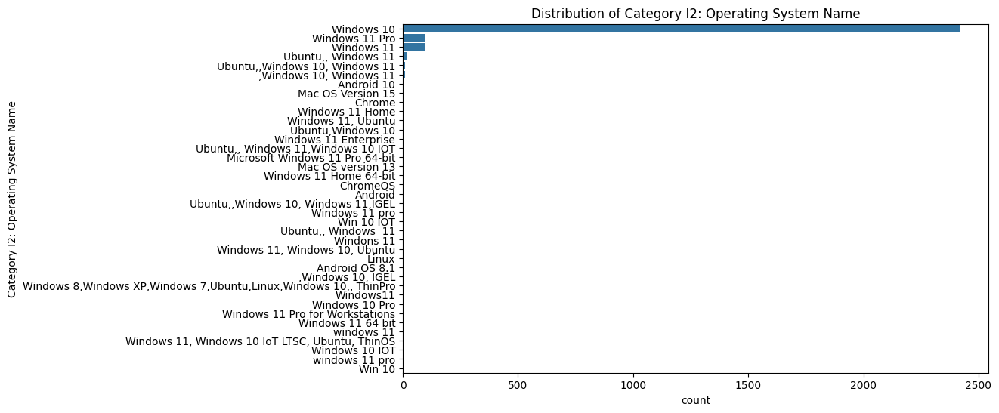


Value Counts for Category I2: Default Low-power Mode:
 Category I2: Default Low-power Mode
Sleep Mode                                                2591
ALPM                                                        35
Off Mode with Hibernation                                   26
Modern Standby                                              22
Connected Sleep                                             18
Modern Standby Mode                                          8
Modern standby                                               7
Modern Starndby                                              2
modernstandby                                                2
Off Mode                                                     2
Sleep Mode, Connected Sleep                                  1
Off Mode with Hibernation, Sleep Mode, Connected Sleep       1
Sleep Mode Connected Sleep                                   1
Moderm Standby                                               1
Long Idle Mode            

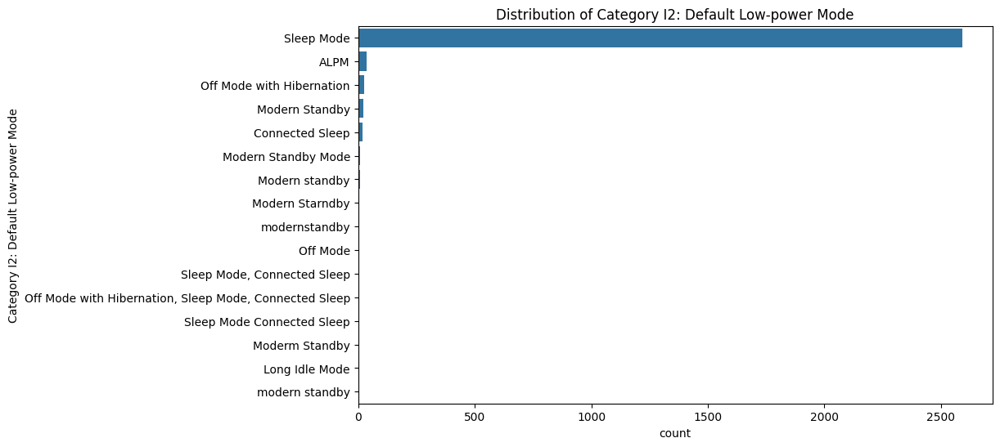


Value Counts for Category I2: Long Idle Power Used for Sleep Mode:
 Category I2: Long Idle Power Used for Sleep Mode
No     2641
Yes      78
Name: count, dtype: int64


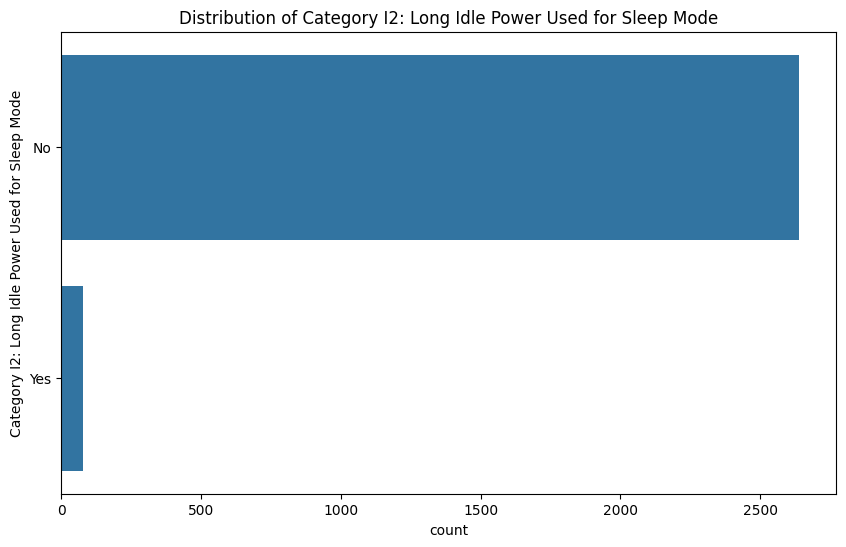


Value Counts for Category D1: Processor Brand:
 Category D1: Processor Brand
Intel    2698
Other      18
AMD         3
Name: count, dtype: int64


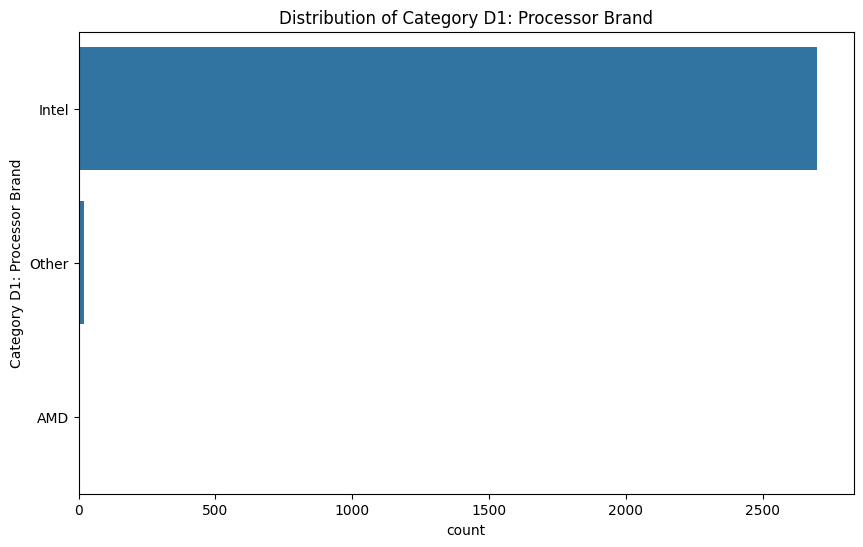


Value Counts for Category D1: Processor Name:
 Category D1: Processor Name
Pentium                                 2650
Celeron                                   17
300                                       12
G7400                                      8
Pentium Gold                               4
Athlon                                     3
Gold G5620                                 3
Pentium,Other                              3
Celeron G4900T                             2
Gold G6400                                 2
G5900                                      2
Intel � 300                                2
Pentium Gold G7400                         2
G4930                                      1
Pentium G6400T                             1
G6400                                      1
Intel Pentium GoldG6500T                   1
Gold G5420                                 1
Intel Pentium Gold G5600T                  1
11th Gen Intel(R) Core(TM) i5-11400T       1
Pentium G7400           

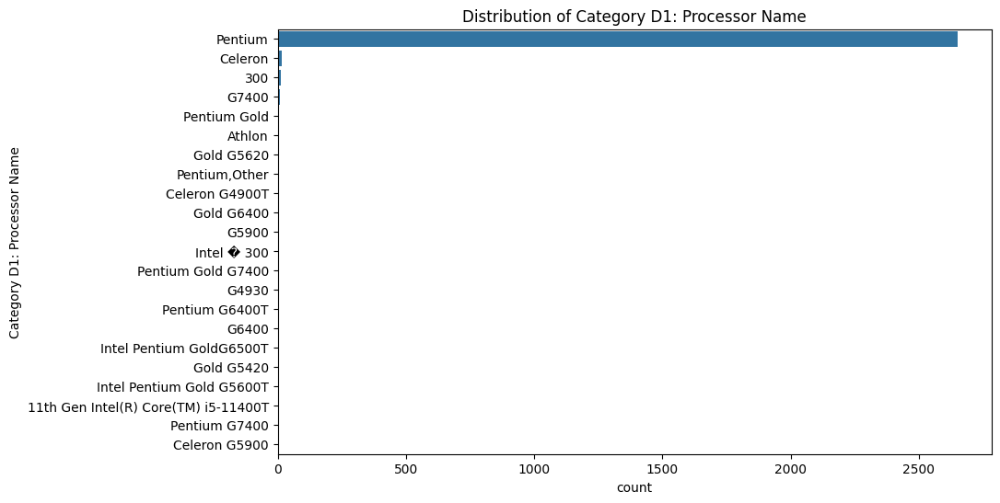


Value Counts for Category D1: Operating System Name:
 Category D1: Operating System Name
Windows 10                        2660
Windows 11 Pro                      24
Windows 11                          12
Ubuntu,, Windows 11                  6
Ubuntu,,Windows 10, Windows 11       4
,Windows 10, Windows 11              4
Windows 11, Ubuntu                   2
Windpws 11 Pro                       2
Windows 11 Home 64-bit               2
Ubuntu,, Windows  11                 1
Ubuntu,Windows 10                    1
Ubuntu,Windows 10,, Windows 11       1
Name: count, dtype: int64


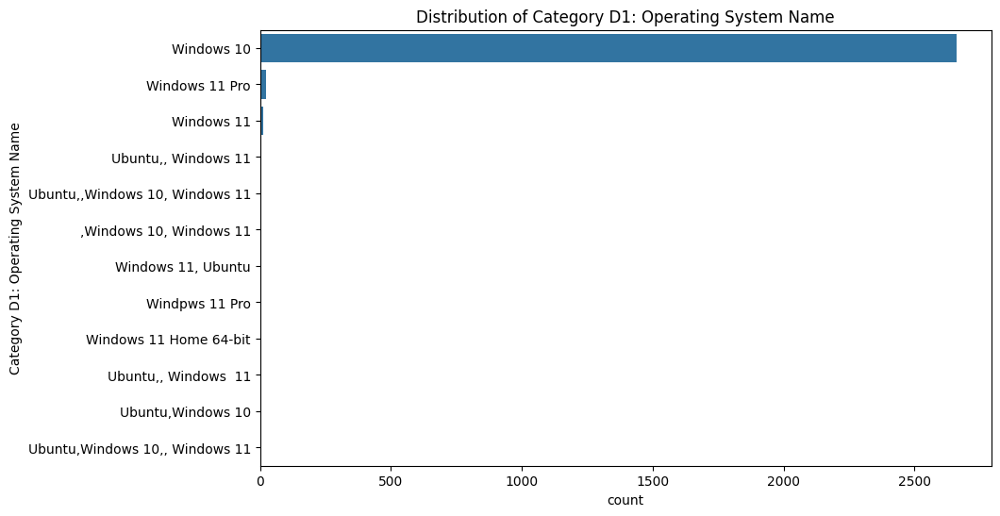


Value Counts for Category D1: Default Low-power Mode:
 Category D1: Default Low-power Mode
Sleep Mode         2711
Modern Standby        4
Connected Sleep       4
Name: count, dtype: int64


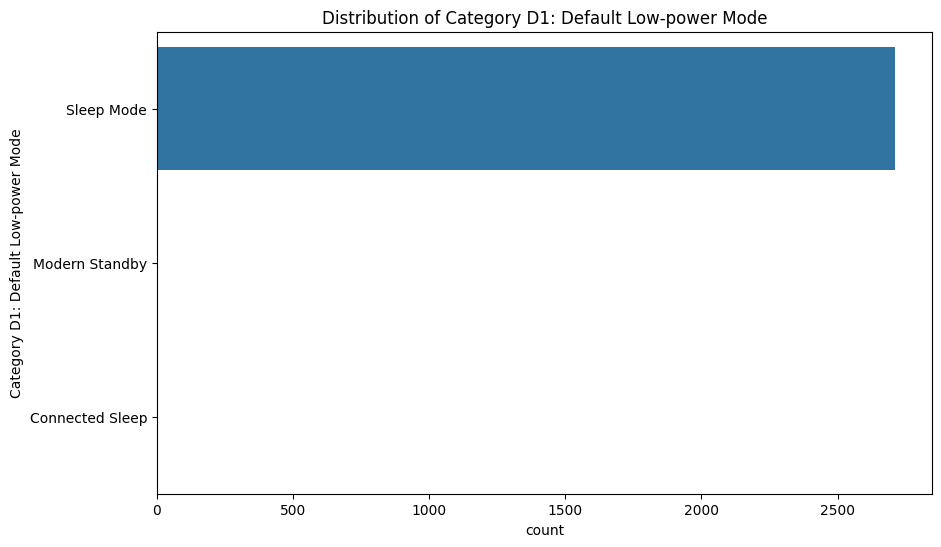


Value Counts for Category D1: Long Idle Power Used for Sleep Mode:
 Category D1: Long Idle Power Used for Sleep Mode
No     2715
Yes       4
Name: count, dtype: int64


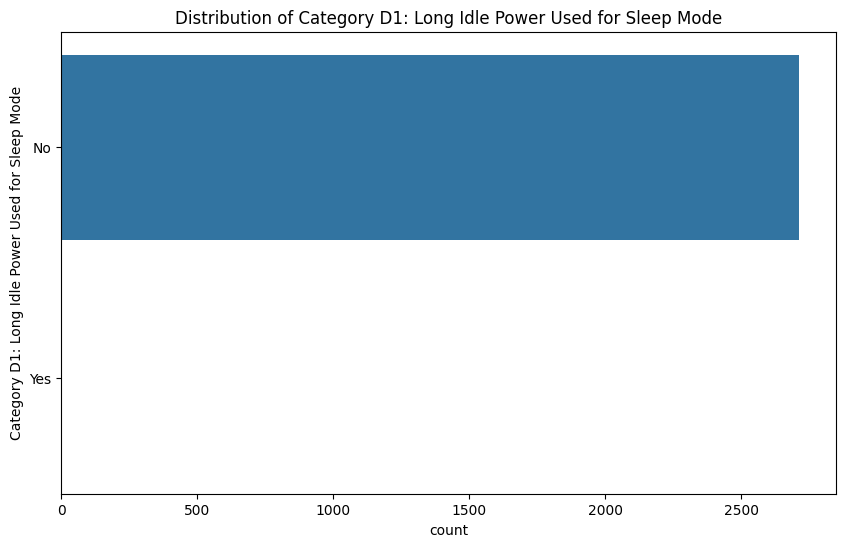


Value Counts for Category D2: Processor Brand:
 Category D2: Processor Brand
Intel    2684
AMD        19
Other      16
Name: count, dtype: int64


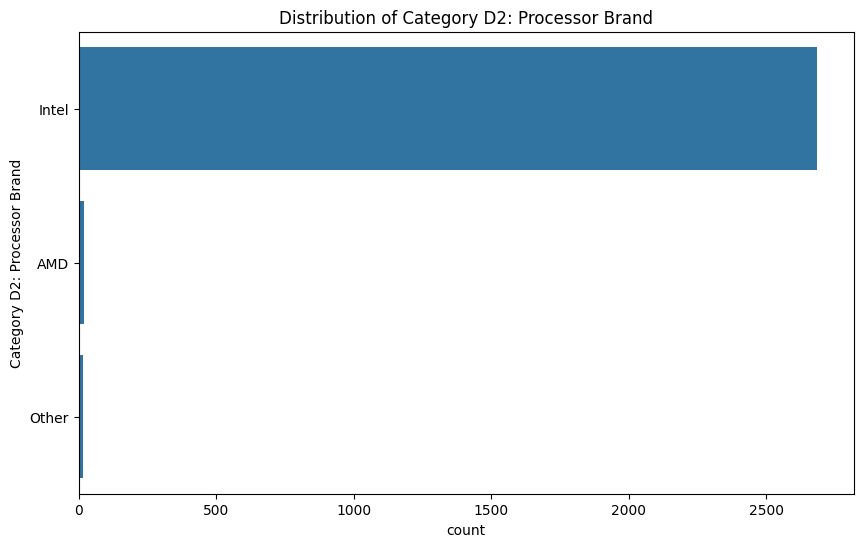


Value Counts for Category D2: Processor Name:
 Category D2: Processor Name
Core i7                  2578
Core i9                    27
Core i5                    16
Ryzen 7                     7
Pentium                     6
                         ... 
i5-13400                    1
I9-13900KF                  1
Core i9-9900                1
AMD Ryzen7-PRO 4750GE       1
i5-11600KF                  1
Name: count, Length: 62, dtype: int64


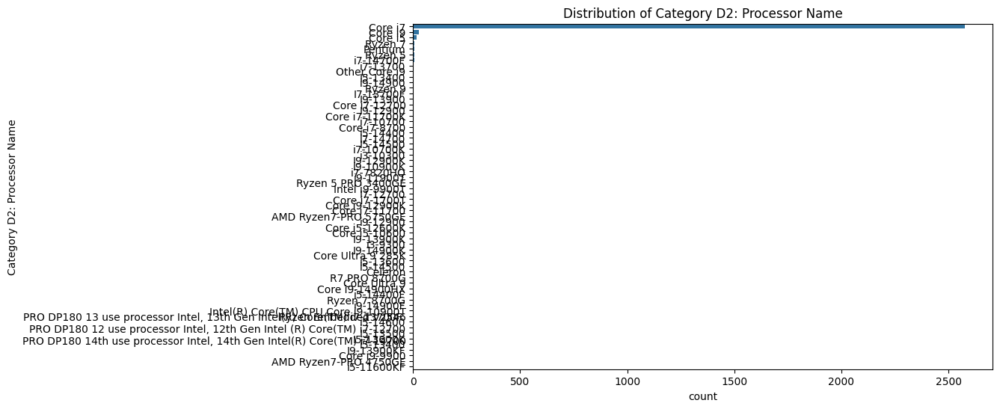


Value Counts for Category D2: Operating System Name:
 Category D2: Operating System Name
Windows 10                            2592
Windows 11 Pro                          53
Windows 11                              37
Ubuntu,,Windows 10, Windows 11           9
,Windows 10, Windows 11                  6
Ubuntu,, Windows 11                      6
Ubuntu,, Windows 11,Windows 10 IOT       3
Windows 11 Home 64-bit                   2
Windows 11, Ubuntu                       2
Ubuntu,Windows 10                        1
Windows 10 Pro                           1
windows 11 22H2                          1
Ubuntu,, Windows  11                     1
Windows Pro 11                           1
WINDOWS 11                               1
Windows11                                1
Windows 11 Home                          1
Windows? 11                              1
Name: count, dtype: int64


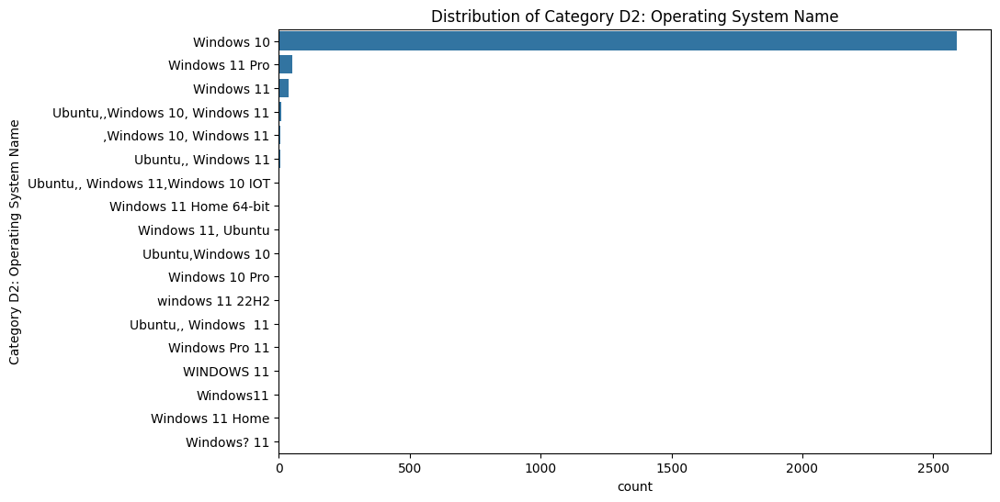


Value Counts for Category D2: Default Low-power Mode:
 Category D2: Default Low-power Mode
Sleep Mode                   2685
Off Mode with Hibernation      17
Modern Standby                  9
Connected Sleep                 6
ALPM                            2
Name: count, dtype: int64


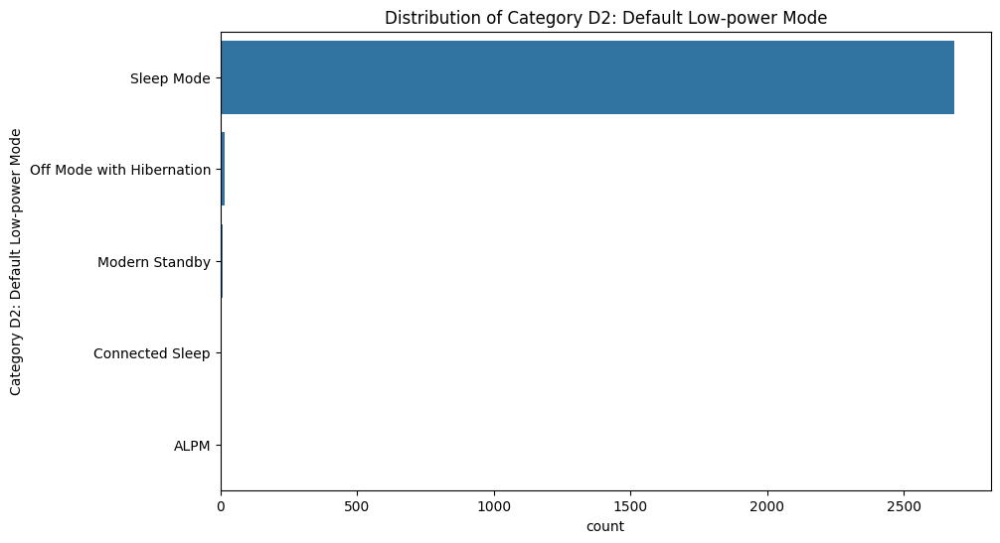


Value Counts for Category D2: Long Idle Power Used for Sleep Mode:
 Category D2: Long Idle Power Used for Sleep Mode
No     2711
Yes       8
Name: count, dtype: int64


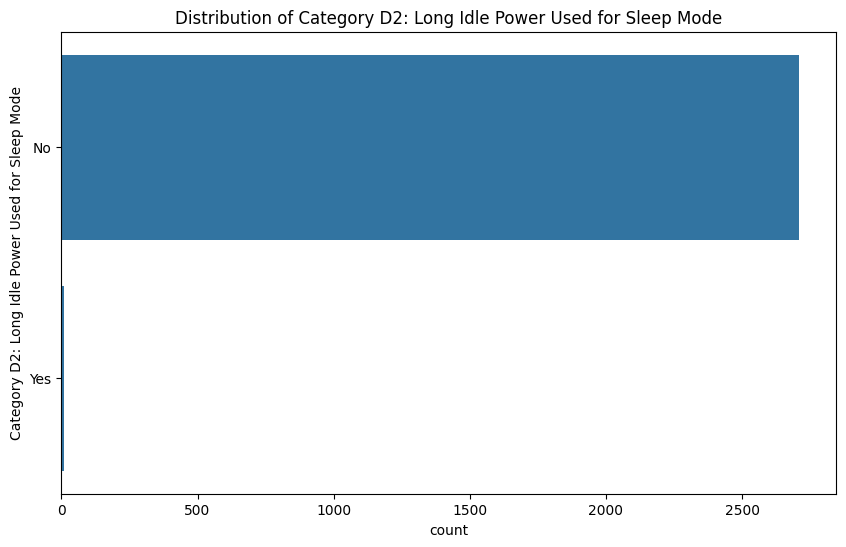


Value Counts for WLAN Capability:
 WLAN Capability
Yes    2650
No       69
Name: count, dtype: int64


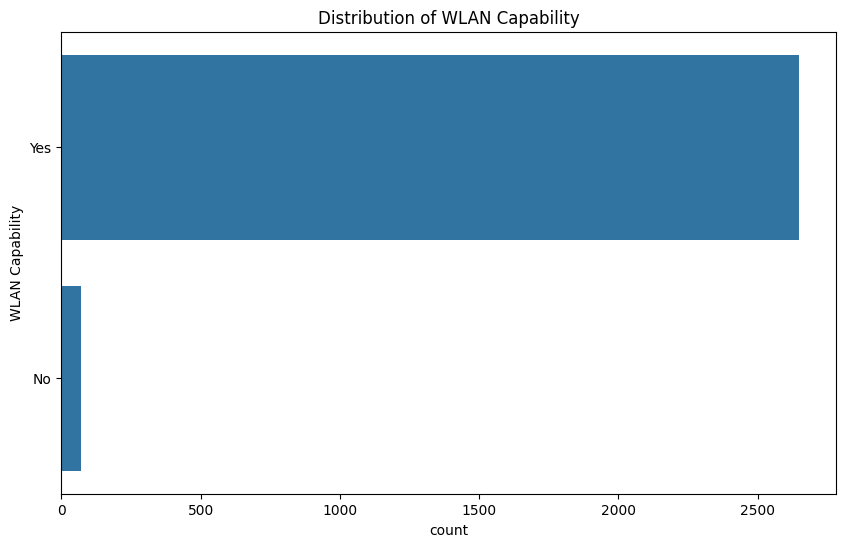


Value Counts for Ethernet Capability:
 Ethernet Capability
Yes    1466
No     1253
Name: count, dtype: int64


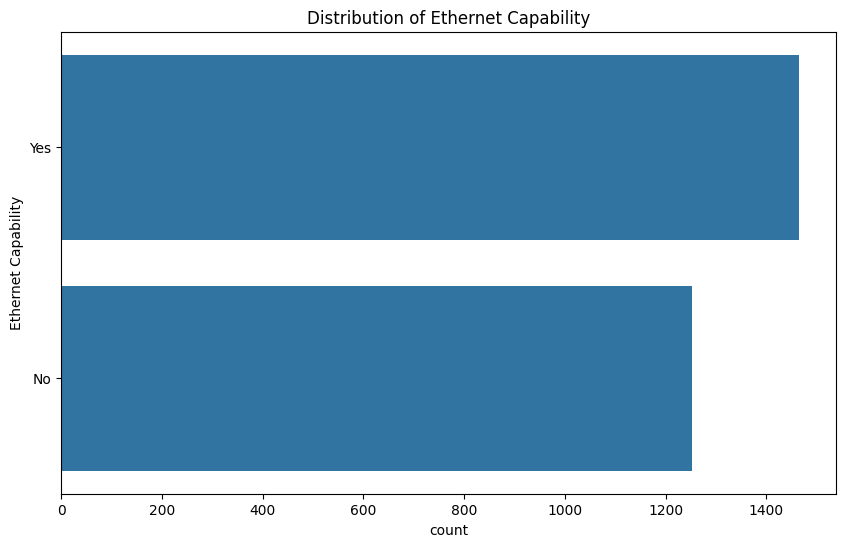


Value Counts for Bluetooth Capability:
 Bluetooth Capability
Yes    2619
No      100
Name: count, dtype: int64


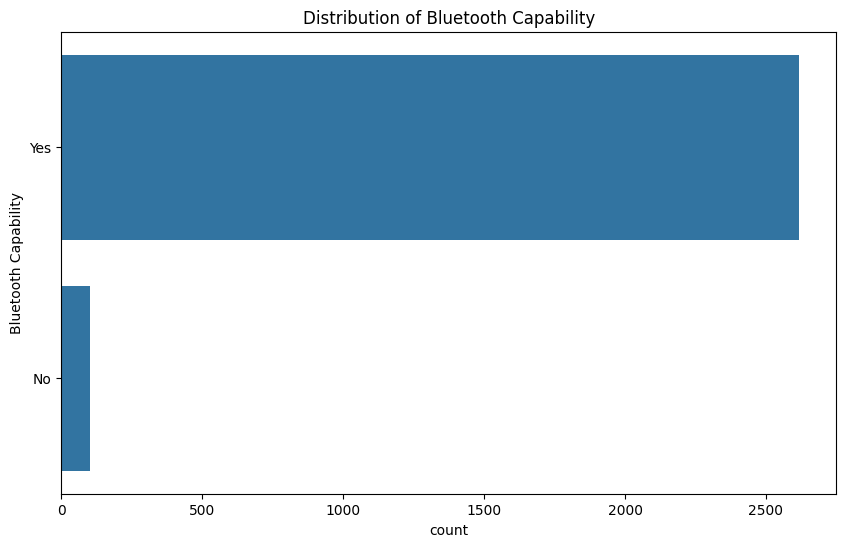


Value Counts for Motherboard Form Factor:
 Motherboard Form Factor
Other           2540
Micro-ATX         61
Standard-ATX      48
Mini-ITX          44
Mini-ATX          15
DTX                5
Nano-ITX           4
Mini-DTX           2
Name: count, dtype: int64


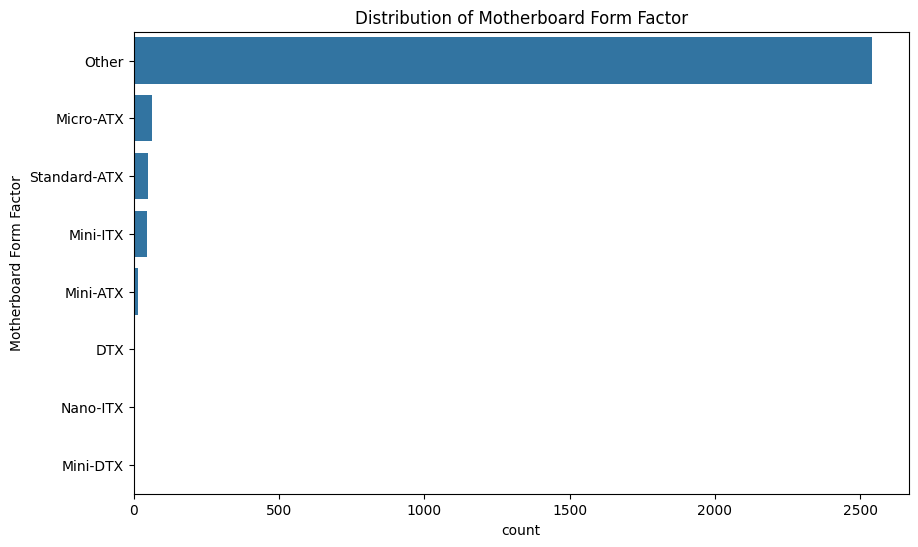


Value Counts for Motherboard Form Factor Other:
 Motherboard Form Factor Other
AIO                   2334
Customized              29
267mm*247mm             18
9.6 inch *9.6 inch      16
SFF                     11
                      ... 
0WSA                     1
220 x 225                1
298 x 528                1
RPOS                     1
5.365x4.528              1
Name: count, Length: 164, dtype: int64


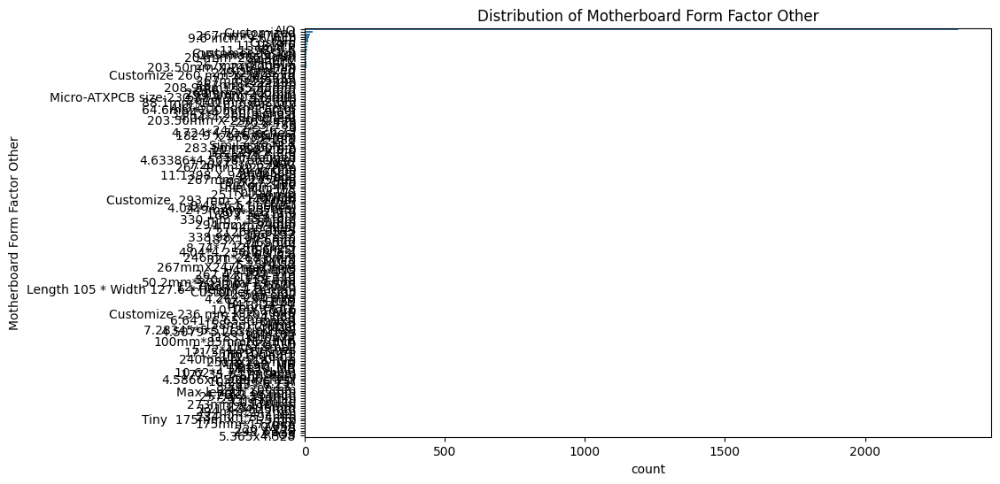


Value Counts for Multi-Channel Memory Support:
 Multi-Channel Memory Support
No     2514
Yes     205
Name: count, dtype: int64


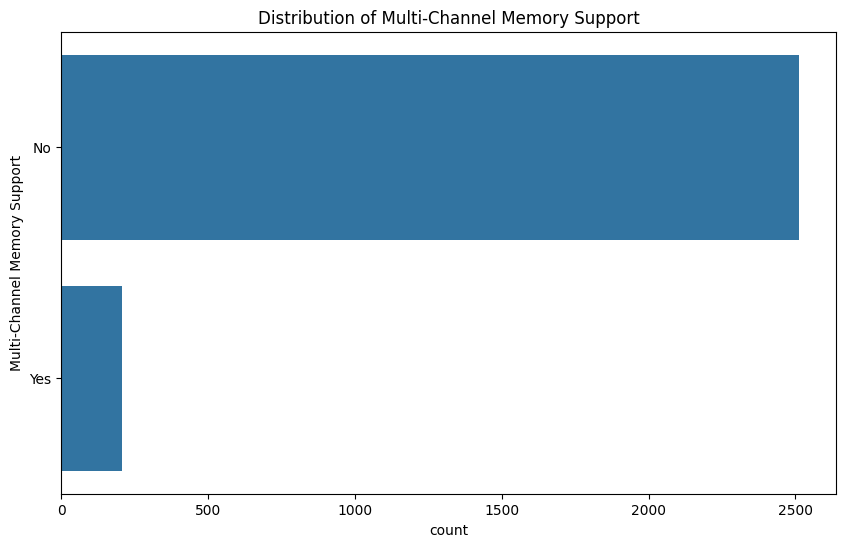


Value Counts for Thin Clients: Processor Brand:
 Thin Clients: Processor Brand
Intel    2714
AMD         5
Name: count, dtype: int64


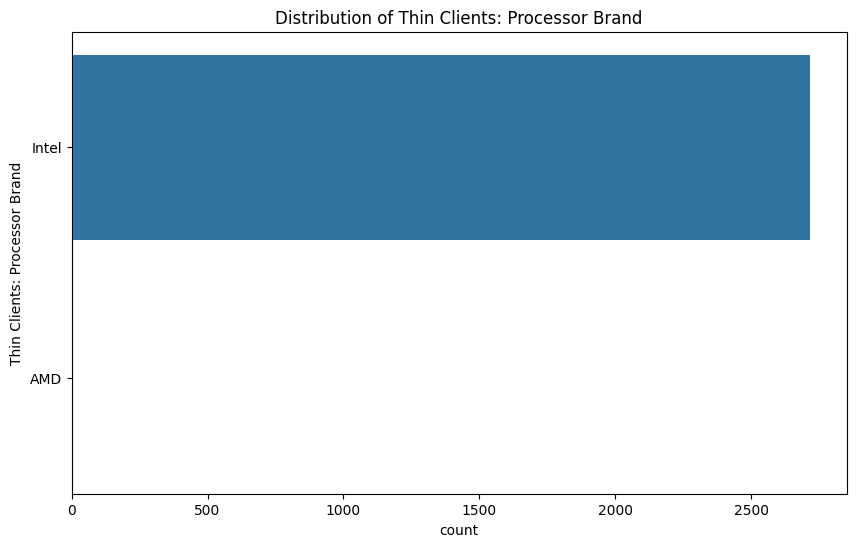


Value Counts for Thin Clients: Processor Name:
 Thin Clients: Processor Name
N6005                                                                      2692
Pentium N6005                                                                 3
Core i7                                                                       2
Pentium                                                                       2
Celeron                                                                       2
A9-9000e                                                                      1
CHT x5-Z8350                                                                  1
J1900                                                                         1
Embedded R1505G with Radeon Vega Gfx                                          1
Celeron J4125                                                                 1
J5005                                                                         1
Ryzen 3 Pro 3300U                         

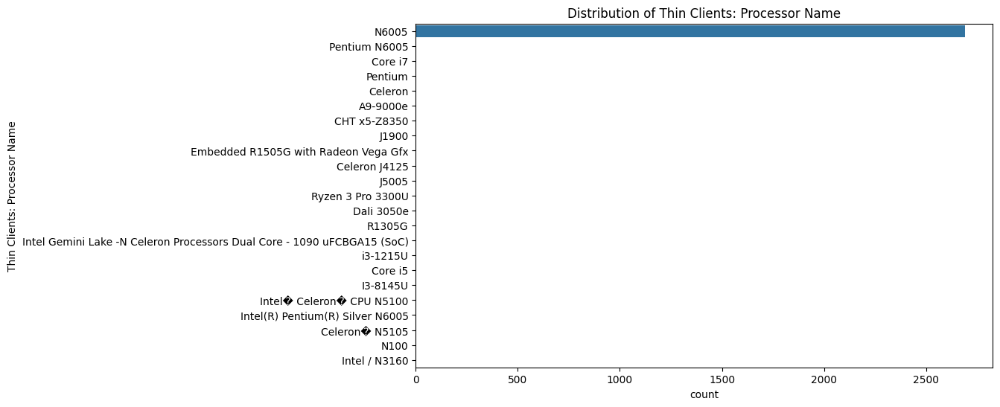


Value Counts for Thin Clients: Operating System Name:
 Thin Clients: Operating System Name
Windows 10                                                           2692
Linux                                                                   3
Chrome OS                                                               3
IGEL OS                                                                 2
ThinPro                                                                 2
Win 10 IoT                                                              2
Windows 10 Enterprise LTSC                                              2
WES7, Win10 IOT, Letos                                                  1
Thin OS(test OS),Windows 10 IoT Enterprise LTSC,Ubuntu,Ubuntu DCL       1
Windowsn10                                                              1
Windows 10 Pro, Linux                                                   1
Win10 IoT                                                               1
LvOS                

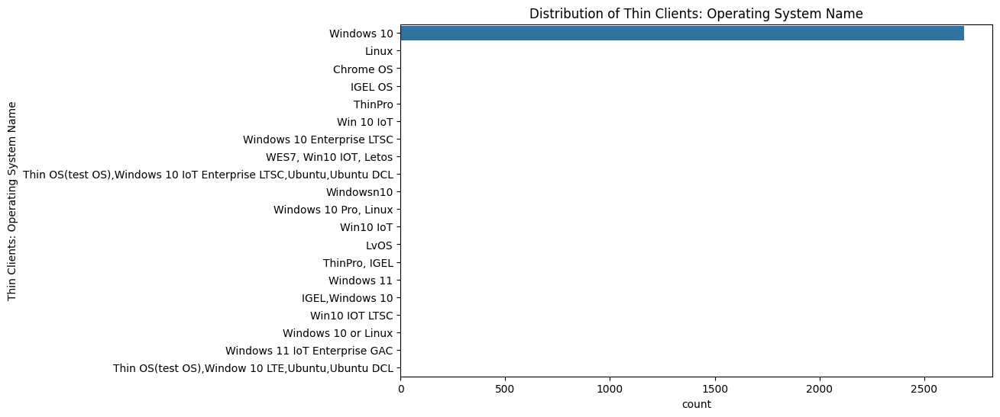


Value Counts for Thin Clients: Long Idle Power Used for Sleep Mode:
 Thin Clients: Long Idle Power Used for Sleep Mode
No     2712
Yes       7
Name: count, dtype: int64


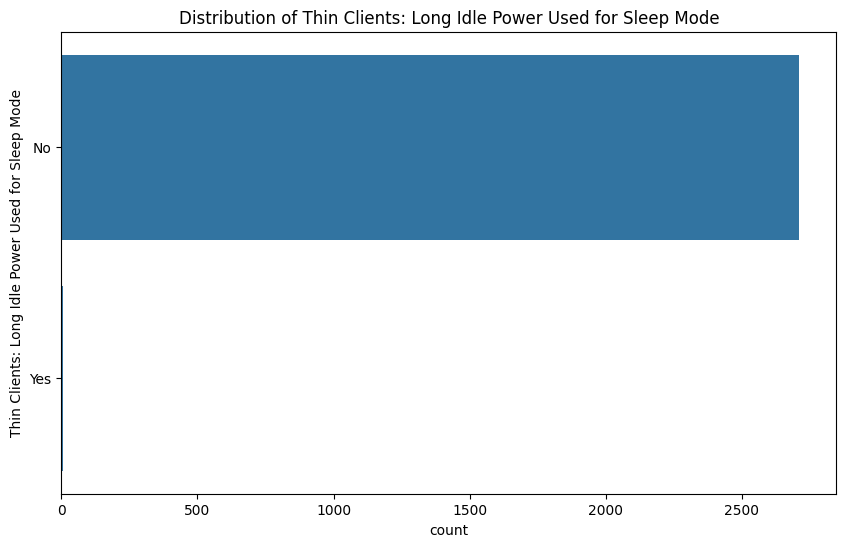


Value Counts for Workstations: Processor Brand:
 Workstations: Processor Brand
Intel    2708
AMD         9
Other       2
Name: count, dtype: int64


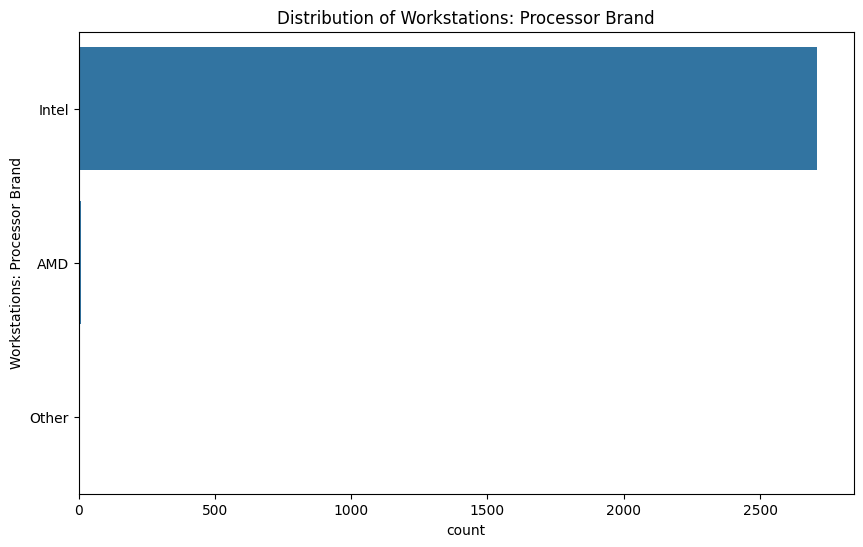


Value Counts for Workstations: Processor Name:
 Workstations: Processor Name
Xeon                                            2652
Core i9                                            4
Core i7                                            4
Ryzen Threadripper                                 3
Xeon W7-2495X                                      2
Xeon W9-3495X                                      2
i9-13900                                           2
Xeon(R) W7_3465x                                   2
Core I7-9700K                                      2
Ryzen Threadripper PRO 7995WX                      2
i9-12900K                                          2
i9-14900                                           2
I9-12900                                           2
XEON PLATINUM 8180                                 2
Xeon W-2155                                        1
i9-7980XE                                          1
Xeon 8280                                          1
I5-11500             

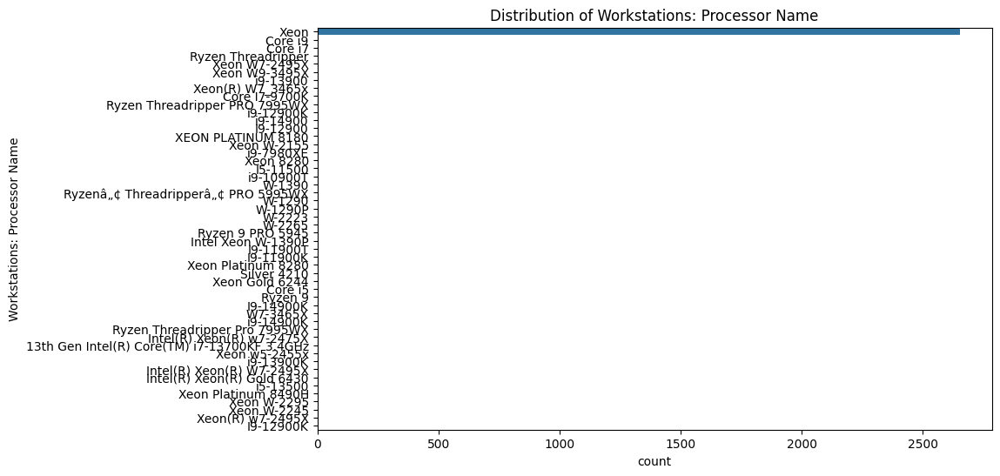


Value Counts for Workstations: Operating System Name:
 Workstations: Operating System Name
Windows 10                         2664
Windows 11                           16
Windows 11 Pro                       15
Windows 11,Windows 10,Ubuntu          7
Windows 10 Pro                        5
Windows 11 64 Pro                     3
Mac OS version 13                     2
Linux                                 1
Ubuntu                                1
Window 11                             1
Win11; Win10 IOT; REHL; Ubuntu        1
Windows 11,Windows IOT                1
Windows 10 Pro for Workstations       1
Windows 10 Enterprise                 1
Name: count, dtype: int64


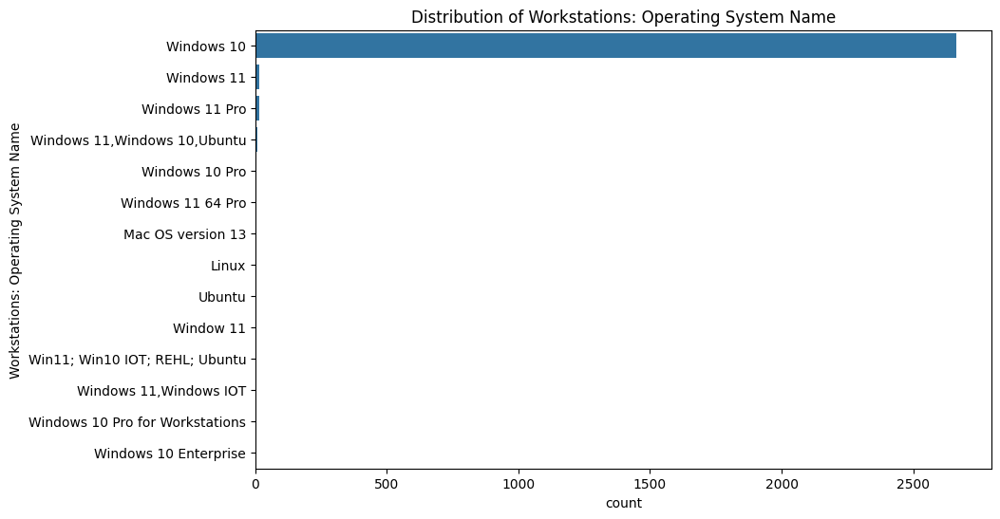


Value Counts for WOL (Wake on LAN) From Sleep:
 WOL (Wake on LAN) From Sleep
Shipped Enabled Under All Conditions                                           2004
Shipped Disabled                                                                545
Shipped Enabled When Operating on Ac Power Only                                 167
Shipped Disabled with Both Client OS and Network Controls to Enable Feature       3
Name: count, dtype: int64


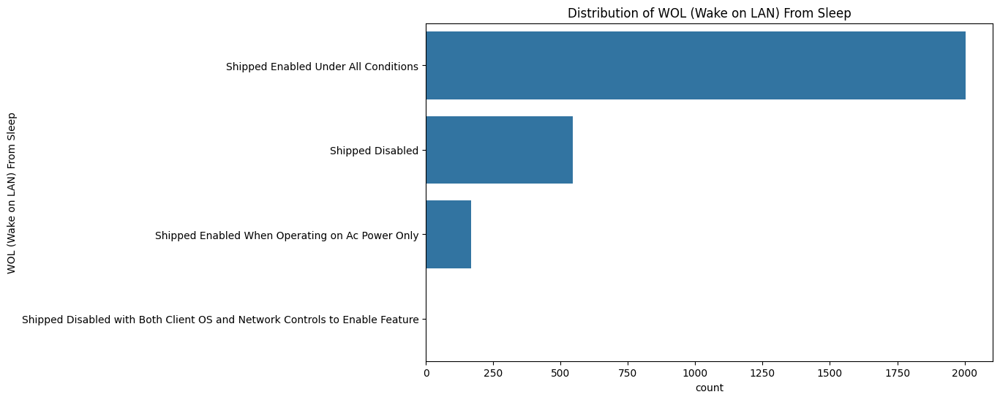

In [13]:

# Step 4: Categorical Feature Analysis
for col in categorical_columns:
    print(f"\nValue Counts for {col}:\n", df[col].value_counts())
    plt.figure(figsize=(10, 6))
    sns.countplot(y=df[col], order=df[col].value_counts().index)
    plt.title(f"Distribution of {col}")
    plt.show()

In [14]:

# Step 5: Insights and Feature Engineering Suggestions
# Identify any redundant or highly correlated features (threshold = 0.9)
threshold = 0.9
high_corr_features = set()
for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > threshold:
            high_corr_features.add(correlation_matrix.columns[i])

print("\nHighly Correlated Features (above 0.9):", high_corr_features)


Highly Correlated Features (above 0.9): {'Category 0: TEC of Model (kWh)', 'Thin Clients: TEC Requirement (kWh)', 'Category D1: TEC of Model (kWh)', 'Workstations: Weighted Power of Model (watts)', 'Workstations: Short Idle (watts)', 'Thin Clients: TEC of Model (kWh)', 'Category I1: TEC of Model (kWh)', 'Category I2: TEC of Model (kWh)', 'Category I1: Functional Adder Allowances (kWh)', 'Category 2: TEC of Model (kWh)'}


In [15]:
# Drop one feature from highly correlated pairs (optional)
df = df.drop(columns=high_corr_features, errors='ignore')

In [16]:
# Final Cleaned Dataset Overview
print("\nCleaned Dataset Overview:")
print(df.info())


Cleaned Dataset Overview:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2719 entries, 0 to 2718
Columns: 161 entries, ENERGY STAR Unique ID to WOL (Wake on LAN) From Sleep
dtypes: float64(102), int64(1), object(58)
memory usage: 3.3+ MB
None


In [17]:
print("\nSample Rows from Cleaned Dataset:")
df.head()


Sample Rows from Cleaned Dataset:


,ENERGY STAR Unique ID,ENERGY STAR Partner,Brand Name,Model Name,Model Number,Additional Model Information,UPC,Type,Touch Screen,"Notebooks, Desktops, Integrated Computers, Slate/Tablets, Two-in-one Notebooks, and Portable All-in-ones Category for TEC (Typical Energy Consumption) Criteria",...,Workstations: Operating System Name,Workstations: Base Processor Speed Per Core (GHz),Workstations: System Memory (GB),Workstations: Hard Drives (count),Workstations: Off Mode (watts),Workstations: Sleep Mode (watts),Workstations: Long Idle (watts),Sleep Mode Default Time Upon Shipment (min.),Display Sleep Mode Default Time Upon Shipment (min.),WOL (Wake on LAN) From Sleep
0,3722052,Apple Inc.,Apple,MacBook Pro 16-inch (M4 Pro),A3403,",MX2T3,; ,MX2X3,",5604008017449,Notebook,Yes,2,...,Windows 10,2.7,128.0,3.0,0.95,4.5,52.5,10.0,10.0,Shipped Enabled Under All Conditions
1,3722040,Apple Inc.,Apple,MacBook Pro 16-inch (M4 Max),A3186,",MX2V3,; ,MX2W3,; ,MX303,; ,MX313,; ,Z1FP,; ,Z...",195949868528;195949868702;195949868979;1959498...,Notebook,Yes,2,...,Windows 10,2.7,128.0,3.0,0.95,4.5,52.5,10.0,10.0,Shipped Enabled Under All Conditions
2,3722039,Apple Inc.,Apple,MacBook Pro 16-inch (M4 Max),A3186,",MX2V3,; ,MX303,",5604008017449,Notebook,Yes,2,...,Windows 10,2.7,128.0,3.0,0.95,4.5,52.5,10.0,10.0,Shipped Enabled Under All Conditions
3,3722027,Apple Inc.,Apple,MacBook Pro 14-inch (M4 Pro),A3401,",MX2E3,; ,MX2H3,",5604008017449,Notebook,Yes,2,...,Windows 10,2.7,128.0,3.0,0.95,4.5,52.5,10.0,10.0,Shipped Enabled Under All Conditions
4,3722023,Apple Inc.,Apple,MacBook Pro 14-inch (M4 Max),A3185,",MX2G3,; ,MX2K3,",5604008017449,Notebook,Yes,2,...,Windows 10,2.7,128.0,3.0,0.95,4.5,52.5,10.0,10.0,Shipped Enabled Under All Conditions


## Focused Insights for Key Factors

In [ ]:

important_columns = [
'Category 0: TEC of Model (kWh)', 
'Category 1: TEC of Model (kWh)', 
'Category 2: TEC of Model (kWh)', 
'Category I1: TEC of Model (kWh)', 
'Category I2: TEC of Model (kWh)', 
'Category D1: TEC of Model (kWh)', 
'Category D2: TEC of Model (kWh)',
'Category 0: Off Mode (watts)', 
'Category 0: Sleep Mode (watts)', 
'Category 0: Long Idle (watts)', 
'Category 0: Short Idle (watts)', 
'Category 1: Off Mode (watts)', 
'Category 1: Sleep Mode (watts)', 
'Category 1: Long Idle (watts)', 
'Category 1: Short Idle (watts)', 
'Category 2: Off Mode (watts)', 
'Category 2: Sleep Mode (watts)', 
'Category 2: Long Idle (watts)', 
'Category 2: Short Idle (watts)', 
'Workstations: Off Mode (watts)', 
'Workstations: Sleep Mode (watts)', 
'Workstations: Long Idle (watts)', 
'Workstations: Short Idle (watts)', 
'Workstations: TEC of Model (kWh)', 
'Workstations: Processor Brand', 
'Workstations: Processor Name', 
'Workstations: Operating System Name', 
'Workstations: Base Processor Speed Per Core (GHz)', 
'Workstations: System Memory (GB)', 
'Workstations: Hard Drives (count)',
'Workstations: Power Management State (watts)', 
'Workstations: Weighted Power of Model (watts)', 
'Workstations: Idle Power (watts)',
'Workstations: Power of Model (watts)'
]

In [32]:
# Generate insights for energy-related columns
energy_columns = [col for col in important_columns if 'Power' in col or 'TEC' in col]
print("\nEnergy Consumption Insights:")
for col in energy_columns:
    if col in df.columns:
        print(f"\nAnalysis of {col}:")
        col_data = pd.to_numeric(df[col], errors='coerce').dropna()
        print(f"Mean: {col_data.mean()}")
        print(f"Median: {col_data.median()}")
        print(f"Standard Deviation: {col_data.std()}")
        print(f"Min: {col_data.min()}")
        print(f"Max: {col_data.max()}")


Energy Consumption Insights:

Analysis of Category 1: TEC of Model (kWh):
Mean: 16.20584773813902
Median: 16.2
Standard Deviation: 2.0258245372050756
Min: 1.3
Max: 32.6

Analysis of Category D2: TEC of Model (kWh):
Mean: 84.63652077969843
Median: 84.5
Standard Deviation: 6.850885321329666
Min: 39.8
Max: 161.4


In [33]:
# Generate insights for processor and system specs
processor_columns = [col for col in important_columns if 'Processor' in col or 'System Memory' in col]
print("\nProcessor and System Specs Insights:")
for col in processor_columns:
    if col in df.columns:
        print(f"\nAnalysis of {col}:")
        print(f"Unique Values: {df[col].nunique()}")
        print(f"Top Value: {df[col].mode()[0]}")
        print(f"Frequency of Top Value: {df[col].value_counts().iloc[0]}")
        
        # If numeric, print summary statistics
        if df[col].dtype in ['int64', 'float64']:
            print(f"Mean: {df[col].mean()}")
            print(f"Median: {df[col].median()}")
            print(f"Standard Deviation: {df[col].std()}")
            print(f"Min: {df[col].min()}")
            print(f"Max: {df[col].max()}")


Processor and System Specs Insights:

Analysis of Workstations: Processor Brand:
Unique Values: 3
Top Value: Intel
Frequency of Top Value: 2708

Analysis of Workstations: Processor Name:
Unique Values: 50
Top Value: Xeon
Frequency of Top Value: 2652

Analysis of Workstations: Base Processor Speed Per Core (GHz):
Unique Values: 23
Top Value: 2.7
Frequency of Top Value: 2636
Mean: 2.706399411548363
Median: 2.7
Standard Deviation: 0.1266954920132895
Min: 1.5
Max: 4.6

Analysis of Workstations: System Memory (GB):
Unique Values: 14
Top Value: 128.0
Frequency of Top Value: 2660
Mean: 135.31445384332474
Median: 128.0
Standard Deviation: 118.64360055290574
Min: 16.0
Max: 4096.0


In [35]:
# Power-related columns insights
power_columns = [col for col in important_columns if 'Sleep Mode' in col or 'WOL' in col]
print("\nPower and Sleep Mode Insights:")
for col in power_columns:
    if col in df.columns:
        print(f"\nAnalysis of {col}:")
        if df[col].dtype == 'object':
            print(f"Unique Values: {df[col].nunique()}")
            print(f"Top Value: {df[col].mode()[0]}")
            print(f"Frequency of Top Value: {df[col].value_counts().iloc[0]}")
        else:
            print(f"Mean: {df[col].mean()}")
            print(f"Median: {df[col].median()}")
            print(f"Standard Deviation: {df[col].std()}")
            print(f"Min: {df[col].min()}")
            print(f"Max: {df[col].max()}")


Power and Sleep Mode Insights:

Analysis of Category 0: Sleep Mode (watts):
Mean: 0.6007355645457888
Median: 0.6
Standard Deviation: 0.03806644239208792
Min: 0.1
Max: 1.9

Analysis of Category 1: Sleep Mode (watts):
Mean: 0.5405663847002574
Median: 0.5
Standard Deviation: 0.2099226597899564
Min: 0.1
Max: 4.0

Analysis of Category 2: Sleep Mode (watts):
Mean: 0.8638837808017654
Median: 0.8
Standard Deviation: 0.45636427818762826
Min: 0.0
Max: 5.6

Analysis of Workstations: Sleep Mode (watts):
Mean: 4.780728208900331
Median: 4.5
Standard Deviation: 4.690600489278218
Min: 0.8
Max: 144.2


In [19]:
# Save cleaned dataset
df.to_csv('cleaned_dataset.csv', index=False)